In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load
!pip install torchmetrics
!pip install torchmetrics[detection]
!pip install torchvision
!pip install pytorch-msssim
!pip install scikit-image

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from matplotlib import pyplot as plt
import pandas as pd
import torch
import torchvision
from collections import OrderedDict

# !pip install torchviz
# !pip install onnx
# !pip install onnxscript
# !pip install onnxruntime

# !pip install 'ray[tune]'
# !pip install -U 'ray[default]'
# !pip install -U ipywidgets
# !pip install optuna
# !pip install pycocotools

  Obtaining dependency information for pycocotools>2.0.0 from https://files.pythonhosted.org/packages/ba/64/0451cf41a00fd5ac4501de4ea0e395b7d909e09d665e56890b5d3809ae26/pycocotools-2.0.7-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 426.2/426.2 kB 15.8 MB/s eta 0:00:00
  Obtaining dependency information for pytorch-msssim from https://files.pythonhosted.org/packages/e2/8c/856047f955acc30179e9255fdc488059ca22f0938519523d53494f7cfee8/pytorch_msssim-1.0.0-py3-none-any.whl.metadata


In [2]:
import wandb
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
api_key = user_secrets.get_secret("wandb_api")
wandb.login(key=api_key)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device ! - {device}")

Device ! - cuda


In [4]:
import os
train_labels = []
val_labels = []
for dirname, _, filenames in os.walk('/kaggle/input/cityscapes-depth-and-segmentation/data/train'):
    for filename in filenames:
        train_labels.append(filename)
for dirname, _, filenames in os.walk('/kaggle/input/cityscapes-depth-and-segmentation/data/val'):
    for filename in filenames:
        val_labels.append(filename)

In [5]:
import  os
import pandas as pd
import torch
from torchvision.io import read_image
import torchvision
from scipy.interpolate import NearestNDInterpolator
from matplotlib import pyplot as plt
class DataSet(torch.utils.data.Dataset):
    def __init__(self, annotations_file, img_dir, transform=None, all_transform=None):
        self.img_labels = annotations_file
        self.img_dir = img_dir
        self.transform = transform
        self.all_transform = all_transform
        
        self.kernel=torch.ones(9)
        self.kernel=self.kernel.view(3,3)
        self.kernel[1][1] = 3
        self.kernel /= self.kernel.sum()
        self.kernel = self.kernel.view(1,1,3,3)

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        


        transform = torchvision.transforms.CenterCrop((100,210))
        pad = torchvision.transforms.Pad((23,14,23,14),padding_mode="edge")
        image_x =  torch.Tensor(np.load(os.path.join(self.img_dir,"image", self.img_labels[idx])) )
        image_y_depth =  torch.Tensor(np.load(os.path.join(self.img_dir,"depth", self.img_labels[idx])))
#         image_y_depth =  transform(image_y_depth.view(1,128,256))
#         image_y_depth= torch.stack([pad(torch.nn.functional.conv2d( image_y_depth.view(1,100,210), torch.nn.Parameter(self.kernel), padding='same').detach().view(100,210))]).permute(1,2,0)
            
#         image_y_depth = (np.load(os.path.join(self.img_dir,"depth", self.img_labels[idx]))*255).astype("uint8")
        image_y_depth = (image_y_depth.numpy()*255).astype("uint8")
        data = image_y_depth
        mask = np.where(~(data <=0.4))
        interp = NearestNDInterpolator(np.transpose(mask), data[mask])
        image_result = interp(*np.indices(data.shape))
        image_y_depth = (torch.Tensor(image_result)/255)
        image_y_depth = pad(transform((image_y_depth.view(1,128,256)))).permute(1,2,0)
        image_y_depth = image_y_depth / image_y_depth.max()
        
        image_y_label =  torch.Tensor(np.load(os.path.join(self.img_dir,"label", self.img_labels[idx])) )
        
        if self.transform:
            tr_x = self.transform(image=image_x.numpy())
            image_x = torch.from_numpy(tr_x["image"])
        if self.all_transform:
            tr_y = self.all_transform(image=image_x.numpy(),masks=[image_y_depth.numpy(),image_y_label.numpy()])
            image_x,image_y_depth,image_y_label = torch.from_numpy(tr_y["image"]),torch.from_numpy(tr_y["masks"][0]),torch.from_numpy(tr_y["masks"][1])
        return image_x.permute(2,0,1),image_y_depth.permute(2,0,1),torch.nn.functional.one_hot((image_y_label+1).long(),20).permute(2,0,1)

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [6]:
def collate(batch):
    final_images_x = []
    final_images_depth = []
    final_images_label = []
    for data in batch:
        final_images_x.append(data[0])
        final_images_depth.append(data[1])
        final_images_label.append(data[2])
    return list(zip(final_images_x,final_images_depth,final_images_label))

In [7]:
# train_labels = train_labels[:100]
# val_labels= val_labels[:5]

In [8]:
import albumentations as A
x_transform = A.Compose([
#     A.RandomCrop(width=650, height=800),
    A.RandomBrightnessContrast(p=0.5),
#     A.GridDistortion(p=0.3),
    A.Downscale(p=0.4,scale_min=0.7, scale_max=0.85),
    A.Sharpen((0,1),p=1)

])
transform = A.Compose([
#     A.Rotate(20,p=0.6)
],is_check_shapes=False)

/opt/conda/lib/python3.10/site-packages/albumentations/augmentations/transforms.py:1692: UserWarning: Using default interpolation INTER_NEAREST, which is sub-optimal.Please specify interpolation mode for downscale and upscale explicitly.For additional information see this PR https://github.com/albumentations-team/albumentations/pull/584
  warnings.warn(


In [9]:
from torch.utils.data import DataLoader
train_dataset = DataSet(train_labels,"/kaggle/input/cityscapes-depth-and-segmentation/data/train",transform=x_transform,all_transform=transform)


vis_loader = DataLoader(train_dataset,shuffle=False,batch_size=4,collate_fn=collate)


In [10]:
def visualize():
    vis_iter = iter(vis_loader)
    data = next(vis_iter)
    for x,depth,label in data:
        fig,axs = plt.subplots(1,3,figsize=(20,10))
        axs[0].imshow(x.permute(1,2,0))
        axs[1].imshow(depth.permute(1,2,0))
        axs[2].imshow(label.argmax(0))
        

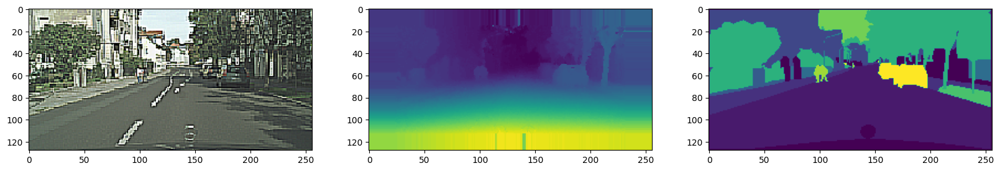

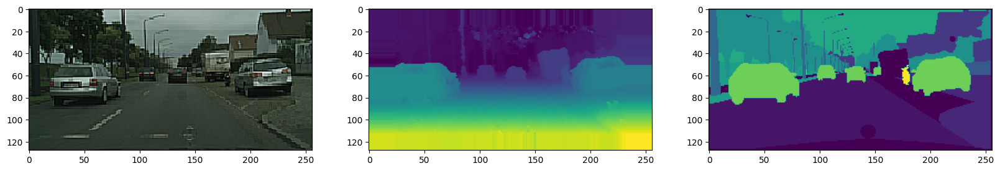

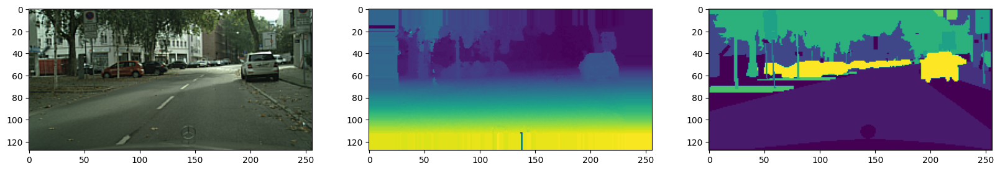

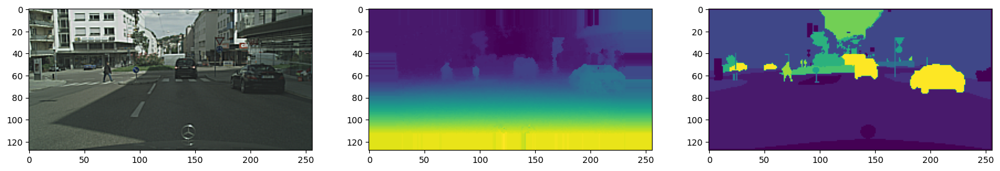

In [11]:
visualize()

In [12]:
from torchvision.models.segmentation import deeplabv3_resnet50
from torchvision.models.segmentation import DeepLabV3_ResNet50_Weights 
import torch
import torchvision
train_loader = DataLoader(train_dataset,shuffle=True,batch_size=20)
# model1 = deeplabv3_resnet50(weights=DeepLabV3_ResNet50_Weights.DEFAULT)
# model1

In [13]:
# from torchvision.models import resnet50
# from torchvision.models import ResNet50_Weights
# resnet = resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)
# resnet.avgpool = torch.nn.Identity()
# resnet.fc = torch.nn.Identity()
# resnet

In [14]:
# from torchviz import make_dot
# def torchviz_model(model):
#     train_gen = iter(train_loader)
#     imgs_x,depth_imgs_y,imgs_y = next(train_gen)
#     y = model(imgs_x)
#     return make_dot(y["out"].mean() + y["aux"].mean(), params=dict(model.named_parameters()),show_attrs=True, show_saved=True).render("/kaggle/working/resnetarch",format="png")
# # viz_model(model1)

In [15]:
class ViSmodel(torch.nn.Module):
    def __init__(self,model):
        super(ViSmodel, self).__init__()
        self.model = model
    
    def forward(self, x):
        return self.model(x)

In [16]:
def viz_model(model):
    train_gen = iter(train_loader)
    imgs_x,depth_imgs_y,imgs_y = next(train_gen)
    model.train()
    torch.onnx.export(model.to(device),
                     imgs_x.to(device),
                     "/kaggle/working/model_adnen.onnx",
                     verbose=False,
                     export_params=True,
                     )

In [17]:
# viz_model(ViSmodel(model))

In [18]:
class CrossStitsh(torch.nn.Module):
    def __init__(self):
        super(CrossStitsh, self).__init__()
        self.weight = torch.nn.Parameter(data=torch.ones(4).view(2,2), requires_grad=True).to(device)
        torch.nn.init.eye_(self.weight)
        
    
    def forward(self, X_1,X_2):
        sh = X_1.shape
        X_1=torch.flatten(X_1)
        X_2=torch.flatten(X_2)
        X=torch.stack((X_1,X_2))
        result = self.weight.matmul(X)
        return result[0].view(sh),result[1].view(sh)


In [19]:
def printnorm(self, input, output):
    # input is a tuple of packed inputs
    # output is a Tensor. output.data is the Tensor we are interested
    print('Inside ' + self.__class__.__name__ + ' forward')
    print('')
    print('input: ', type(input))
    print('input[0]: ', type(input[0]))
    print('output: ', type(output))
    print('')
    print('input size:', input[0].size())
    print('output size:', output.data.size())
    print('output norm:', output.data.norm())




In [20]:
from torchvision.models.segmentation.deeplabv3 import ASPP
class MergeBlock(torch.nn.Module):
    def __init__(self,num_classes):
        super(MergeBlock, self).__init__()
        
#         self.aspps = torch.nn.ModuleList([self.getaspp(256,128),self.getaspp(512,128),self.getaspp(1024,128)])

        self.c1x1_net = torch.nn.ModuleList([self.get1x1(256,128),self.get1x1(512,128),self.get1x1(1024,128)])
        self.c1x1 = torch.nn.ModuleList([self.get1x1(256,128),self.get1x1(256,128),self.get1x1(256,128)])
        self.c3x3_final = [self.get3x3(128,num_classes),self.get3x3(128,num_classes),self.get3x3(128,num_classes),self.get3x3(128,num_classes)]
        self.c1x1_aux = torch.nn.Sequential(torch.nn.Conv2d(128, num_classes, 1,1, padding="same", bias=False),torch.nn.ReLU()).to(device)
        self.c3x3_merge = self.get3x3(num_classes*4,num_classes)
    def get1x1(self,input_size,output_size):
        return torch.nn.Sequential(torch.nn.Conv2d(input_size, output_size, 1,1, padding="same", bias=False),torch.nn.BatchNorm2d(output_size),torch.nn.Dropout(0.3),torch.nn.ReLU()).to(device)
        
#     def getaspp(self,input_size,output_size):
#         return torch.nn.Sequential(ASPP(input_size,(4, 12),output_size),torch.nn.Dropout(0.3)).to(device)

    def get3x3(self,input_size,output_size):
        return torch.nn.Sequential(torch.nn.Dropout(0.05),torch.nn.Conv2d(input_size, output_size, 3,1,dilation=1 ,padding="same", bias=False),torch.nn.ReLU()).to(device)
        
        
    def forward(self, x,layers,aux):
        outputs = []
        out_ll = x
        
        outputs.append(torch.nn.functional.interpolate(self.c3x3_final[3](out_ll), size=(128,256), mode="bilinear", align_corners=False))

        for i in reversed(range(0,3)):
            
            # Upscale previous layer
            out_ll = torch.nn.functional.interpolate(out_ll, size=(128//2**(i),256//2**(i)), mode="bilinear", align_corners=False)
                      
            #Upscale incoming layer                                         
            processed_layer = self.c1x1_net[i](layers[i])
            processed_layer = torch.nn.functional.interpolate(processed_layer, size=(128//2**(i),256//2**(i)), mode="bilinear", align_corners=False)

            out_ll = torch.cat((out_ll,processed_layer),dim=1)
            out_ll = self.c1x1[i](out_ll)
            
            outputs.append(torch.nn.functional.interpolate(self.c3x3_final[i](out_ll), size=(128,256), mode="bilinear", align_corners=False))

        

        
        aux = self.c1x1_aux(aux)
        aux = torch.nn.functional.interpolate(aux, size=(128,256), mode="bilinear", align_corners=False)

        return aux,sum(outputs)


In [21]:
from torchvision.models import resnet50
from torchvision.models import ResNet50_Weights

class MultiTaskNN(torch.nn.Module):
    
    def getModel(output):
#         model = deeplabv3_resnet50(weights=DeepLabV3_ResNet50_Weights.DEFAULT)
        model = deeplabv3_resnet50(weights=None)

        resnet = resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)
        resnet.avgpool = torch.nn.Identity()
        resnet.fc = torch.nn.Identity()
        model.backbone = resnet
        model.classifier = torchvision.models.segmentation.deeplabv3.DeepLabHead(2048,output)
        model.aux_classifier = torchvision.models.segmentation.deeplabv3.FCNHead(1024,output)
        return model
    
    def __init__(self):
        super().__init__()
        self.cs = [CrossStitsh(),CrossStitsh(),CrossStitsh(),CrossStitsh()]
        self.model_1=MultiTaskNN.getModel(128)
        self.model_2=MultiTaskNN.getModel(128)
        
        self.merge_1 = MergeBlock(20)
        self.merge_2 = MergeBlock(1)
        
        self.merge_1.to(device)
        self.merge_2.to(device)
        

    def _unfreeze_model(model):
#         for param in model.parameters():
#             param.requires_grad = False
#         for param in model.classifier.parameters():
#             param.requires_grad = True
#         for param in model.aux_classifier.parameters():
#             param.requires_grad = True
        for param in model.backbone.parameters():
            param.requires_grad = True
            
    def _freeze_model(model):
#         for param in model.parameters():
#             param.requires_grad = False
#         for param in model.classifier.parameters():
#             param.requires_grad = True
#         for param in model.aux_classifier.parameters():
#             param.requires_grad = True
        for param in model.backbone.parameters():
            param.requires_grad = False
        
    def freeze(self): 
        MultiTaskNN._freeze_model(self.model_1)
        MultiTaskNN._freeze_model(self.model_2)
        
    def unfreeze(self): 
        MultiTaskNN._unfreeze_model(self.model_1)
        MultiTaskNN._unfreeze_model(self.model_2)
        
    def getFirstLayers(self,x,model):
        x_1 = model.backbone.conv1(x)
        x_1 = model.backbone.bn1(x_1)
        x_1 = model.backbone.relu(x_1)
        x_1 = model.backbone.maxpool(x_1)
        return x_1
        
    def getLayer(self,x,model,name):
        if(name == "layer1"):
            layer = model.backbone.layer1
        elif(name == "layer2"):
            layer = model.backbone.layer2
        elif(name == "layer3"):
            layer = model.backbone.layer3
        elif(name == "layer4"):
            layer = model.backbone.layer4
#         layer.register_forward_hook(printnorm)
        x_1 = layer(x)
        return x_1
    
        
    
    def predict(self,x,layers,model,output_shape,mergeBlock):
        
        aux = layers[2]
        
        y_pred = model.classifier(x)
        y_aux = model.aux_classifier(aux)

        y_aux,y_pred=mergeBlock(y_pred,layers,y_aux)
        

        return OrderedDict([('out',y_pred),('aux',y_aux)])
    
    def forward(self, x):
        
                
        bl_1 = []
        bl_2 = []
        
        input_shape  = x.shape[-2:]
        
        #N1
        x_1 = self.getFirstLayers(x,self.model_1)
        x_2 = self.getFirstLayers(x,self.model_2)
        
        
        for i in range(1,5):
            layer = "layer"+str(i)
            #L1
            nx_1 = self.getLayer(x_1,self.model_1,layer)
            nx_2 = self.getLayer(x_2,self.model_2,layer)

            #CS1
            nx_1,nx_2 = self.cs[i-1](nx_1,nx_2)
            
            bl_1.append(nx_1)
            bl_2.append(nx_2)
            
#             if(i == 2):
#                 ll_1 = self.getLayer(x_1,self.model_1,layer)
#                 ll_2 = self.getLayer(x_2,self.model_2,layer)
#                 ll_1,ll_2 = self.cs[i-1](ll_1,ll_2)         
                
#             if(i == 3):
#                 aux_1 = self.getLayer(x_1,self.model_1,layer)
#                 aux_2 = self.getLayer(x_2,self.model_2,layer)
#                 aux_1,aux_2 = self.cs[i-1](aux_1,aux_2)
            
            x_1,x_2=nx_1,nx_2
            
        y_1 = self.predict(x_1,bl_1,self.model_1,input_shape,self.merge_1)
        y_2 = self.predict(x_2,bl_2,self.model_2,input_shape,self.merge_2)
    
        return OrderedDict([('task1',y_1),('task2',y_2)])

In [22]:
class AdaptativeLoss(torch.nn.Module):
    def __init__(self):
        super(AdaptativeLoss, self).__init__()
        self.weight = torch.nn.Parameter(data=torch.ones(2), requires_grad=True)
        torch.nn.init.normal_(self.weight,1,0.1)
        
    def forward(self, loss_1,loss_2):
        result = loss_1 / torch.square(self.weight[0])  + loss_2 / torch.square(self.weight[1]) + torch.log(self.weight[0]) +torch.log(self.weight[1])
#         return loss_1+loss_2
        return result

In [23]:
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM

adp = AdaptativeLoss()
model=MultiTaskNN()
model.freeze()
n_epoch = 9
lr = 0.0007
opt = torch.optim.Adam(params=model.parameters(),lr=lr,weight_decay=0.0001)
loss_opt = torch.optim.Adam(params=adp.parameters(),lr=0.001)
lossFn = torch.nn.CrossEntropyLoss()
ssim = SSIM(data_range=1,channel=1,size_average=True)
lossFn_depth = torch.nn.MSELoss()

tuned_epoch = 9
tuned_lr = 0.0007

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 243MB/s]
Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 288MB/s]


In [24]:
def viz_data(data):
    for i,(x,depth,label) in enumerate(data):
        model.eval()
        fig,axs = plt.subplots(2,3,figsize=(20,10))
        axs[0][0].imshow(x.permute(1,2,0))
        axs[0][1].imshow(depth.permute(1,2,0))
        axs[0][2].imshow(label.argmax(0))
        res = model(torch.stack([x]).to(device))

        depth_pred,labels_pred = res["task2"]["out"][0].to("cpu"),res["task1"]["out"][0].to("cpu")

        axs[1][0].imshow(x.permute(1,2,0))
        axs[1][1].imshow(depth_pred.permute(1,2,0).detach())
        axs[1][2].imshow(labels_pred.argmax(0).detach())
        wandb.log({f"plot_{i}": fig})
        plt.show()

In [25]:
val_dataset = DataSet(val_labels,"/kaggle/input/cityscapes-depth-and-segmentation/data/val")
val_loader = DataLoader(val_dataset,shuffle=False,batch_size=4)
val_viz_loader = DataLoader(val_dataset,shuffle=False,batch_size=4,collate_fn=collate)

In [26]:
run=wandb.init(
    # set the wandb project where this run will be logged
    project="City Scapes Cross Stitch Network Multi Task Learning",
    # track hyperparameters and run metadata
    config={
    "learning_rate": lr,
    "fine_tuning_learning_rate": tuned_lr,
    "epochs": n_epoch,
    "fine_tuning_epochs": tuned_epoch,
    "dataset": "cityscapes-depth-and-segmentation",
    "depth_loss": lossFn_depth,
    "labels_loss": lossFn
    }
)
artifact = wandb.Artifact(name="output", type="model")
try:
    os.mkdir("/kaggle/working/models")
except:
    print("Exists!")
artifact.add_dir(local_path="/kaggle/working/models")  # Add dataset directory to artifact

wandb: Currently logged in as: dbzadnen. Use `wandb login --relogin` to force relogin
wandb: Tracking run with wandb version 0.16.0
wandb: Run data is saved locally in /kaggle/working/wandb/run-20231124_143600-lbc1bhw7
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run silvery-vortex-120
wandb: ⭐️ View project at https://wandb.ai/dbzadnen/City%20Scapes%20Cross%20Stitch%20Network%20Multi%20Task%20Learning
wandb: 🚀 View run at https://wandb.ai/dbzadnen/City%20Scapes%20Cross%20Stitch%20Network%20Multi%20Task%20Learning/runs/lbc1bhw7
wandb: Adding directory to artifact (/kaggle/working/models)... Done. 0.0s


In [27]:
from torchmetrics.classification import MulticlassAccuracy,MulticlassConfusionMatrix,BinaryAccuracy
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchmetrics.image import StructuralSimilarityIndexMeasure

def train_model(model,adp,limit=0,init=0):
    model.train()
    model = model.to(device)
    adp = adp.to(device)
#     dropout_modules = [module for module in model.modules() if isinstance(module,torch.nn.Dropout)]
#     [module.eval() for module in dropout_modules] # disable dropout

    # [module.train() for module in dropout_modules] # enable dropout

    for oe in range(limit):
        e = oe + init
        model.train()
        cur_loss = {
            "loss": 0,
            "loss_aux_labels": 0,       
            "loss_aux_depth": 0,
            "loss_labels": 0,
            "loss_depth": 0,
            "loss_out_labels": 0,
            "loss_out_depth": 0
        }

        train_gen = iter(train_loader)
        train_acc = [MulticlassAccuracy(num_classes=20).to(device),StructuralSimilarityIndexMeasure().to(device)]


        for imgs_x,depth_imgs_y,imgs_y in train_gen:

            #Reset 
            opt.zero_grad()

            #Input 
            x = imgs_x
            y_train_labels = imgs_y
            y_train_depth = depth_imgs_y


            x=x.to(device)
            y_train_labels=y_train_labels.to(device)
            y_train_depth=y_train_depth.to(device)


            #Train
            y_pred = model(x)

            y_pred_labels  = y_pred['task1']
            y_pred_depth  = y_pred['task2']


            l1_label = lossFn(y_pred_labels['out'].float(),y_train_labels.float())
            l2_label = lossFn(y_pred_labels['aux'].float(),y_train_labels.float())

            l1_depth = lossFn_depth(y_pred_depth['out'].float(),y_train_depth.float())
            l2_depth = lossFn_depth(y_pred_depth['aux'].float(),y_train_depth.float())

            loss_depth =  l1_depth
            loss_label =  l1_label 

    #         l = loss_depth
    #         l = loss_depth + loss_label

            l = adp(loss_depth,loss_label)

            with torch.no_grad():

                cur_loss["loss"] += l
                cur_loss["loss_aux_labels"] += l2_label
                cur_loss["loss_aux_depth"] += l2_depth
                cur_loss["loss_labels"] += loss_label
                cur_loss["loss_depth"] += loss_depth
                cur_loss["loss_out_labels"] += l1_label
                cur_loss["loss_out_depth"] += l1_depth

                res1=train_acc[0](y_pred_labels['out'].argmax(1),y_train_labels.argmax(1))
                res2=train_acc[1](y_pred_depth["out"],y_train_depth) 

            # Back propagate and optimize
            l.backward()
            opt.step()
            loss_opt.step()

        wandb.log({
            "epoch": e,
            "train_labels_accuracy": train_acc[0].compute(),
            "train_depth_accuracy": train_acc[1].compute(),
            **(dict([("train_"+i,j) for i,j in cur_loss.items()]))
        })

        print(f"----Epoch [{e}] - Loss : {cur_loss} - Acc {train_acc[0].compute(),train_acc[1].compute()}")

        # Validation
        model.eval()
        val_loss = {
            "loss": 0,
            "loss_aux_labels": 0,       
            "loss_aux_depth": 0,
            "loss_labels": 0,
            "loss_depth": 0,
            "loss_out_labels": 0,
            "loss_out_depth": 0
        }

        valid_gen = iter(val_loader)
        valid_acc = [MulticlassAccuracy(num_classes=20).to(device),StructuralSimilarityIndexMeasure().to(device)]

        with torch.no_grad():

            for imgs_x,depth_imgs_y,imgs_y in valid_gen:


                x = imgs_x
                y_valid_labels = imgs_y
                y_valid_depth = depth_imgs_y


                x=x.to(device)
                y_valid_labels=y_valid_labels.to(device)
                y_valid_depth=y_valid_depth.to(device)


                #Train
                y_pred = model(x)

                y_pred_labels  = y_pred['task1']
                y_pred_depth  = y_pred['task2']


                l1_label = lossFn(y_pred_labels['out'].float(),y_valid_labels.float())

                l1_depth = lossFn_depth(y_pred_depth['out'].float(),y_valid_depth.float())

                loss_depth =  l1_depth
                loss_label =  l1_label  

        #         l = loss_depth
                l = adp(loss_depth,loss_label)


                val_loss["loss"] += l
                val_loss["loss_labels"] += loss_label
                val_loss["loss_depth"] += loss_depth
                val_loss["loss_out_labels"] += l1_label
                val_loss["loss_out_depth"] += l1_depth

                res1=valid_acc[0](y_pred_labels['out'].argmax(1),y_valid_labels.argmax(1))
                res2=valid_acc[1](y_pred_depth["out"],y_valid_depth) 

            print(f"VALID****Epoch [{e}] - Loss : {val_loss} - Acc {valid_acc[0].compute(),valid_acc[1].compute()}")

            val_viz_iter = iter(val_viz_loader)
            data = next(val_viz_iter)
            viz_data(data)

            wandb.log({
                "epoch": e,
                "valid_labels_accuracy": valid_acc[0].compute(),
                "valid_depth_accuracy": valid_acc[1].compute(),
                **(dict([("valid_"+i,j) for i,j in val_loss.items()]))
            })
            torch.save(model,f"/kaggle/working/models/model_{e}.torch")
            run.log_artifact(artifact)

----Epoch [0] - Loss : {'loss': tensor(172.8361, device='cuda:0'), 'loss_aux_labels': tensor(1355.9707, device='cuda:0'), 'loss_aux_depth': tensor(99.4138, device='cuda:0'), 'loss_labels': tensor(308.5186, device='cuda:0'), 'loss_depth': tensor(12.0648, device='cuda:0'), 'loss_out_labels': tensor(308.5186, device='cuda:0'), 'loss_out_depth': tensor(12.0648, device='cuda:0')} - Acc (tensor(0.3426, device='cuda:0'), tensor(0.5783, device='cuda:0'))
VALID****Epoch [0] - Loss : {'loss': tensor(-149.6799, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(226.8306, device='cuda:0'), 'loss_depth': tensor(4.3478, device='cuda:0'), 'loss_out_labels': tensor(226.8306, device='cuda:0'), 'loss_out_depth': tensor(4.3478, device='cuda:0')} - Acc (tensor(0.3868, device='cuda:0'), tensor(0.6063, device='cuda:0'))


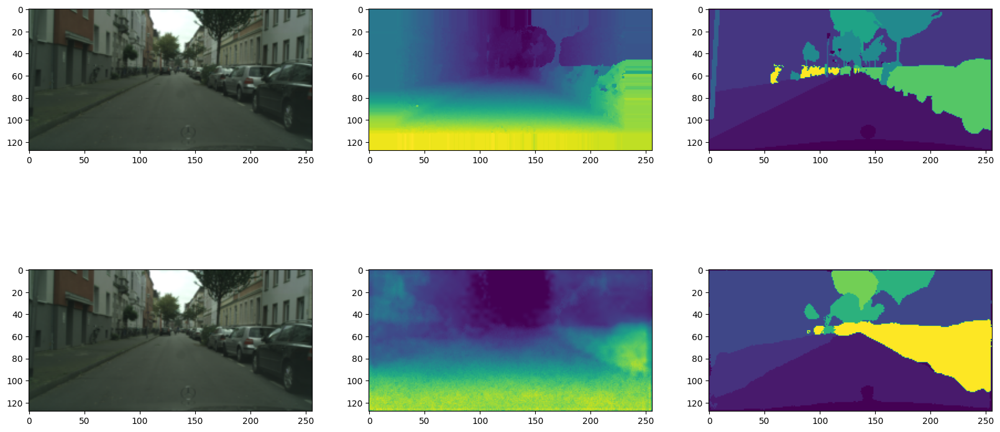

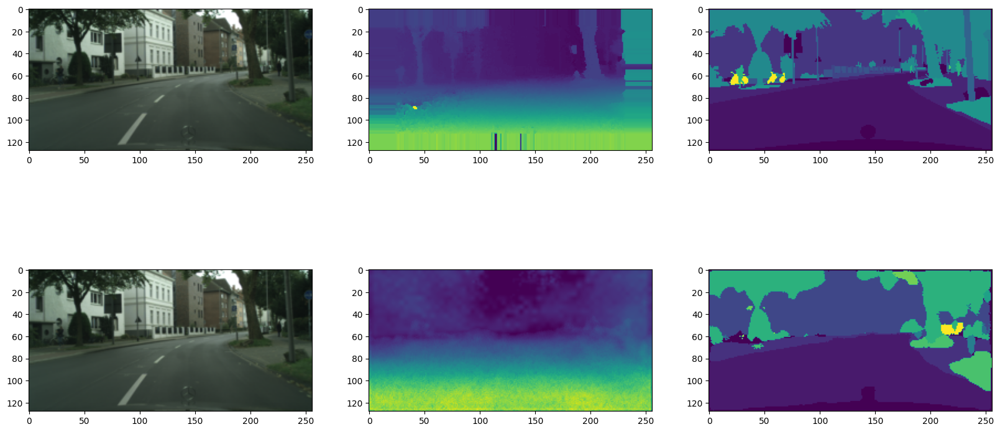

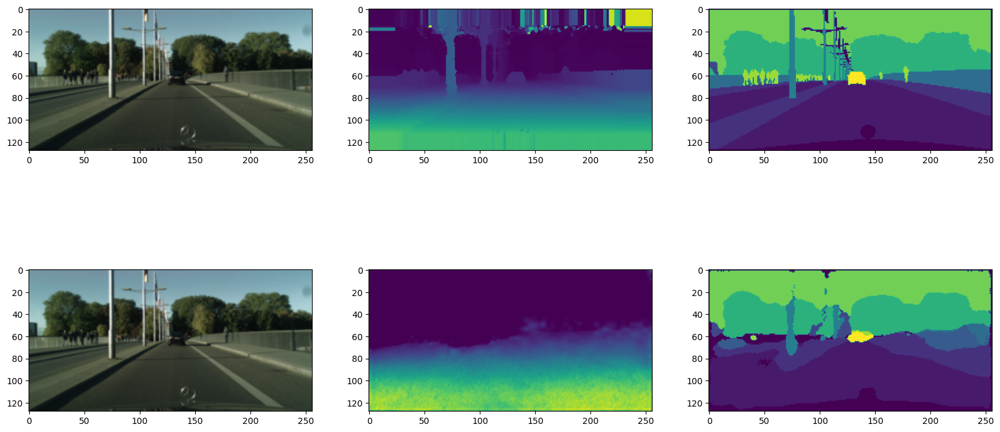

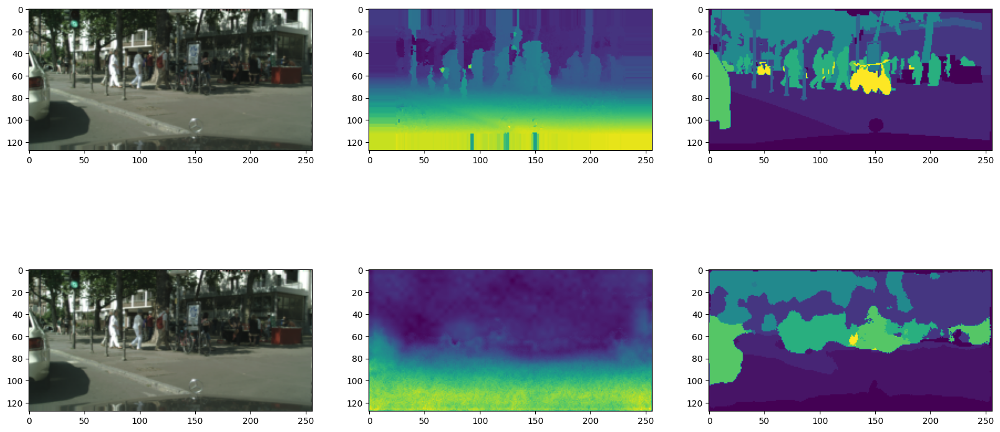

----Epoch [1] - Loss : {'loss': tensor(-137.9135, device='cuda:0'), 'loss_aux_labels': tensor(1355.9199, device='cuda:0'), 'loss_aux_depth': tensor(99.4101, device='cuda:0'), 'loss_labels': tensor(251.6480, device='cuda:0'), 'loss_depth': tensor(5.5525, device='cuda:0'), 'loss_out_labels': tensor(251.6480, device='cuda:0'), 'loss_out_depth': tensor(5.5525, device='cuda:0')} - Acc (tensor(0.4178, device='cuda:0'), tensor(0.5369, device='cuda:0'))
VALID****Epoch [1] - Loss : {'loss': tensor(43.0661, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(218.8395, device='cuda:0'), 'loss_depth': tensor(3.5350, device='cuda:0'), 'loss_out_labels': tensor(218.8395, device='cuda:0'), 'loss_out_depth': tensor(3.5350, device='cuda:0')} - Acc (tensor(0.3893, device='cuda:0'), tensor(0.6969, device='cuda:0'))


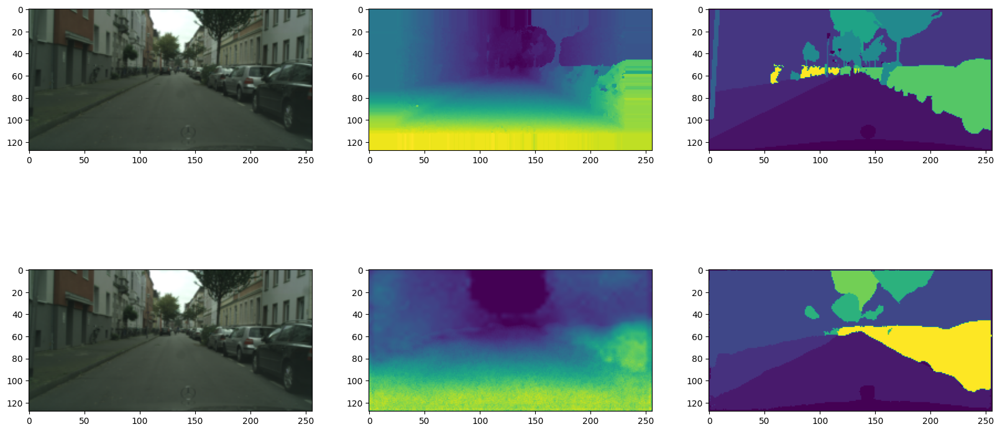

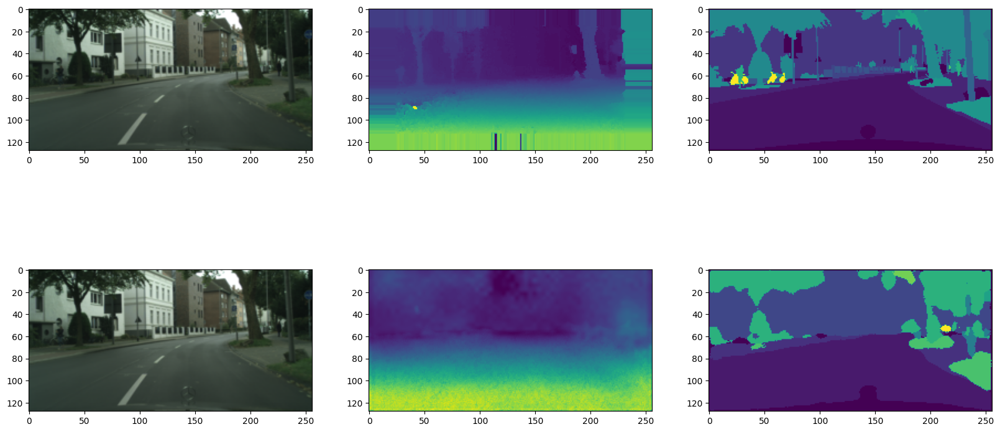

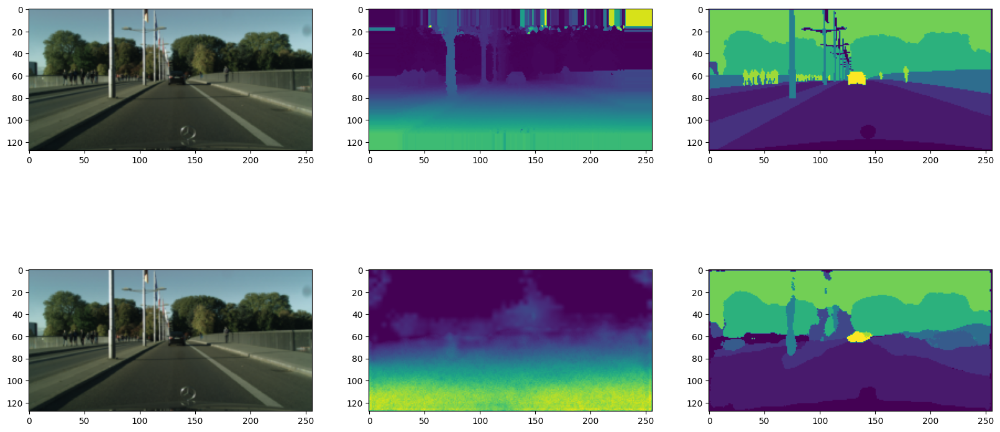

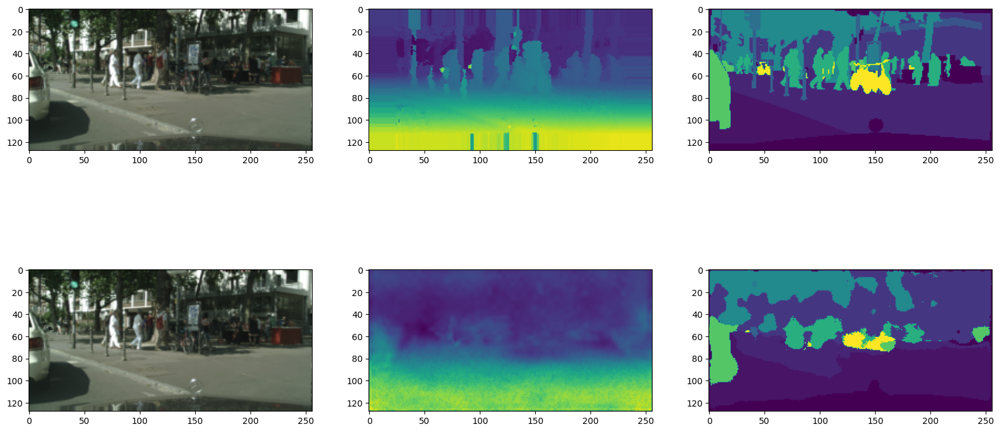

----Epoch [2] - Loss : {'loss': tensor(159.7079, device='cuda:0'), 'loss_aux_labels': tensor(1355.9580, device='cuda:0'), 'loss_aux_depth': tensor(99.3888, device='cuda:0'), 'loss_labels': tensor(241.2221, device='cuda:0'), 'loss_depth': tensor(4.9705, device='cuda:0'), 'loss_out_labels': tensor(241.2221, device='cuda:0'), 'loss_out_depth': tensor(4.9705, device='cuda:0')} - Acc (tensor(0.4414, device='cuda:0'), tensor(0.5255, device='cuda:0'))
VALID****Epoch [2] - Loss : {'loss': tensor(185.0923, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(216.8045, device='cuda:0'), 'loss_depth': tensor(3.4589, device='cuda:0'), 'loss_out_labels': tensor(216.8045, device='cuda:0'), 'loss_out_depth': tensor(3.4589, device='cuda:0')} - Acc (tensor(0.4054, device='cuda:0'), tensor(0.7072, device='cuda:0'))


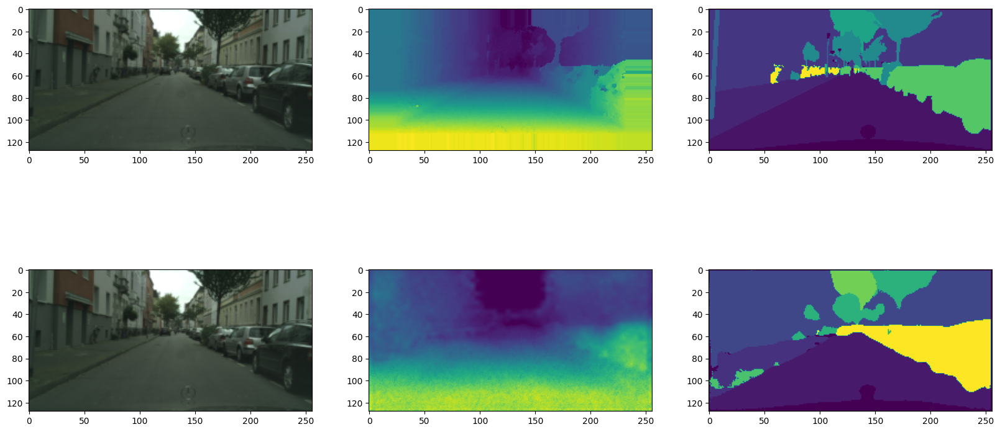

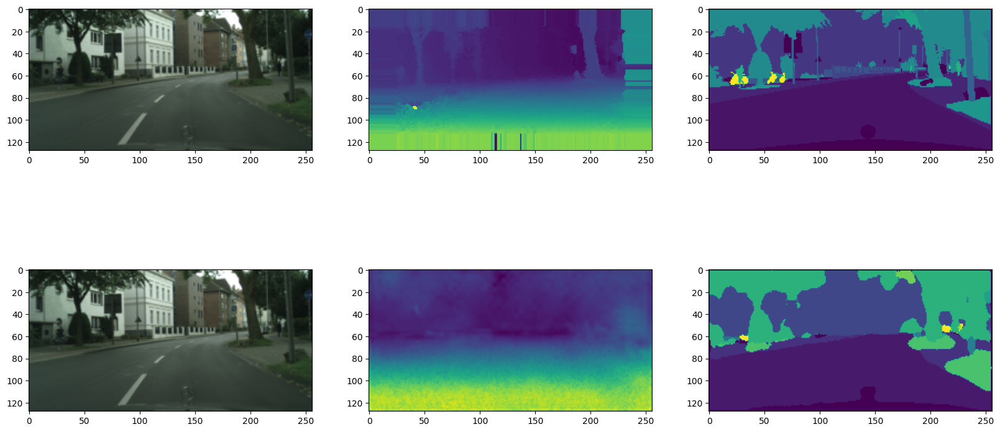

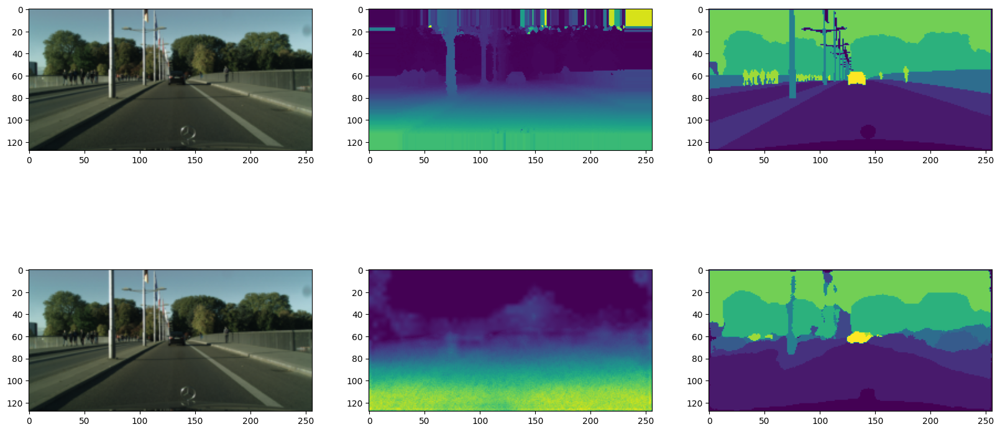

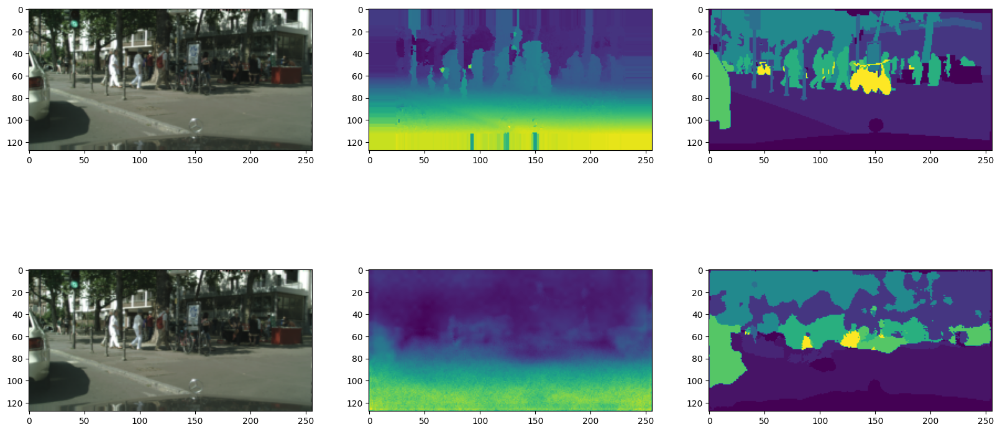

----Epoch [3] - Loss : {'loss': tensor(202.3690, device='cuda:0'), 'loss_aux_labels': tensor(1355.9913, device='cuda:0'), 'loss_aux_depth': tensor(99.4144, device='cuda:0'), 'loss_labels': tensor(240.9323, device='cuda:0'), 'loss_depth': tensor(4.8741, device='cuda:0'), 'loss_out_labels': tensor(240.9323, device='cuda:0'), 'loss_out_depth': tensor(4.8741, device='cuda:0')} - Acc (tensor(0.4450, device='cuda:0'), tensor(0.5343, device='cuda:0'))
VALID****Epoch [3] - Loss : {'loss': tensor(191.8531, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(222.5257, device='cuda:0'), 'loss_depth': tensor(3.5347, device='cuda:0'), 'loss_out_labels': tensor(222.5257, device='cuda:0'), 'loss_out_depth': tensor(3.5347, device='cuda:0')} - Acc (tensor(0.4091, device='cuda:0'), tensor(0.7069, device='cuda:0'))


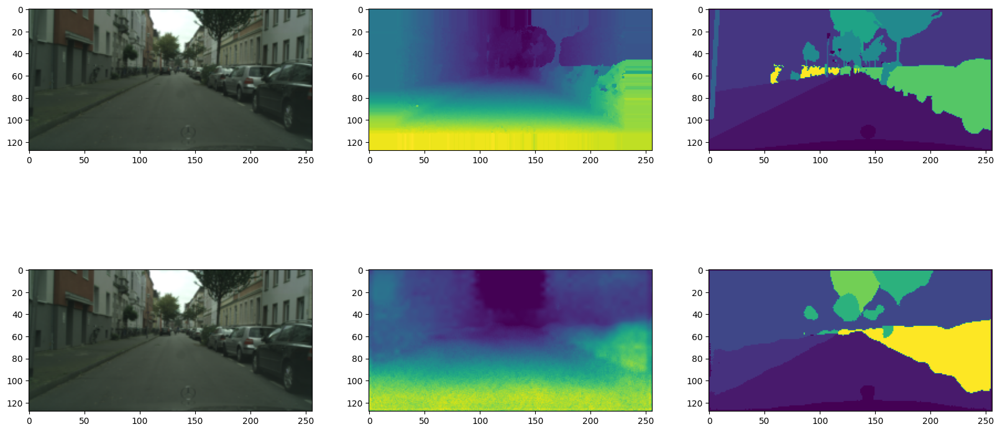

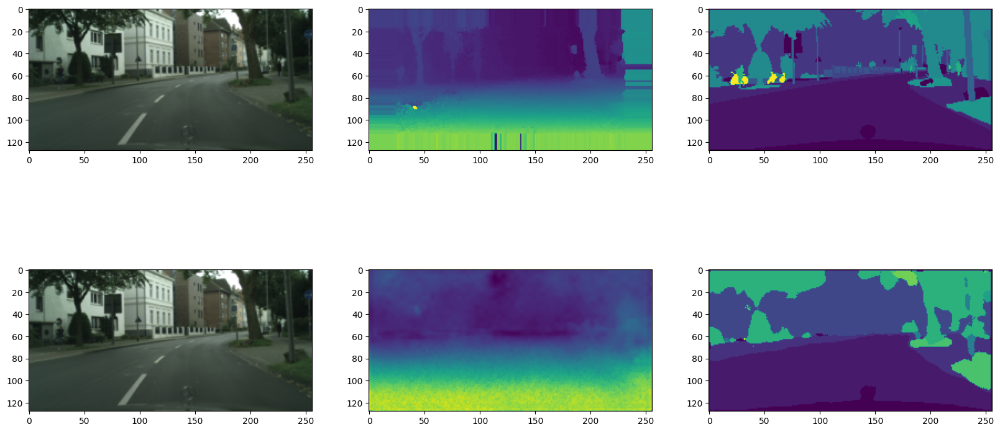

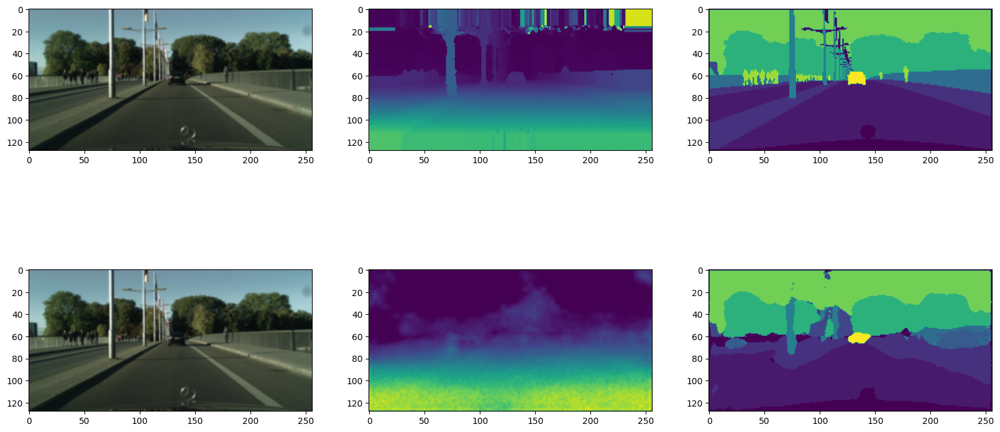

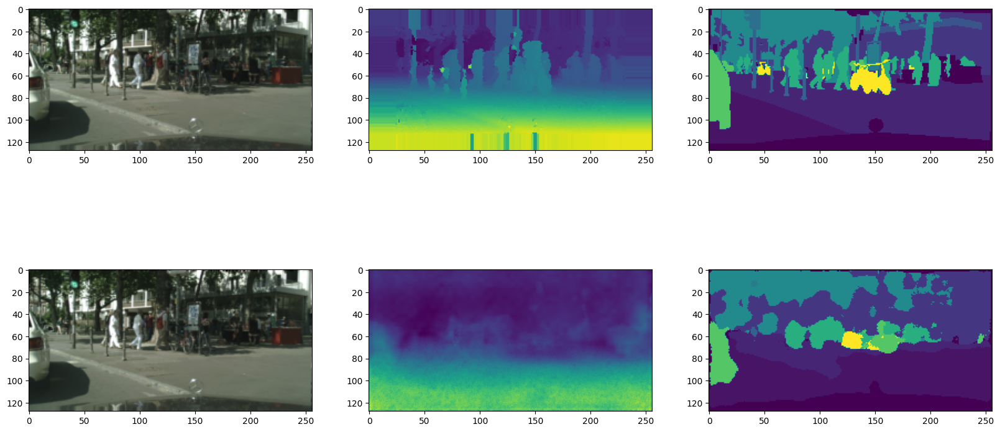

----Epoch [4] - Loss : {'loss': tensor(86.4857, device='cuda:0'), 'loss_aux_labels': tensor(1355.8638, device='cuda:0'), 'loss_aux_depth': tensor(99.4250, device='cuda:0'), 'loss_labels': tensor(233.9422, device='cuda:0'), 'loss_depth': tensor(4.8079, device='cuda:0'), 'loss_out_labels': tensor(233.9422, device='cuda:0'), 'loss_out_depth': tensor(4.8079, device='cuda:0')} - Acc (tensor(0.4627, device='cuda:0'), tensor(0.5376, device='cuda:0'))
VALID****Epoch [4] - Loss : {'loss': tensor(-122.5277, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(208.4850, device='cuda:0'), 'loss_depth': tensor(3.5226, device='cuda:0'), 'loss_out_labels': tensor(208.4850, device='cuda:0'), 'loss_out_depth': tensor(3.5226, device='cuda:0')} - Acc (tensor(0.4244, device='cuda:0'), tensor(0.7076, device='cuda:0'))


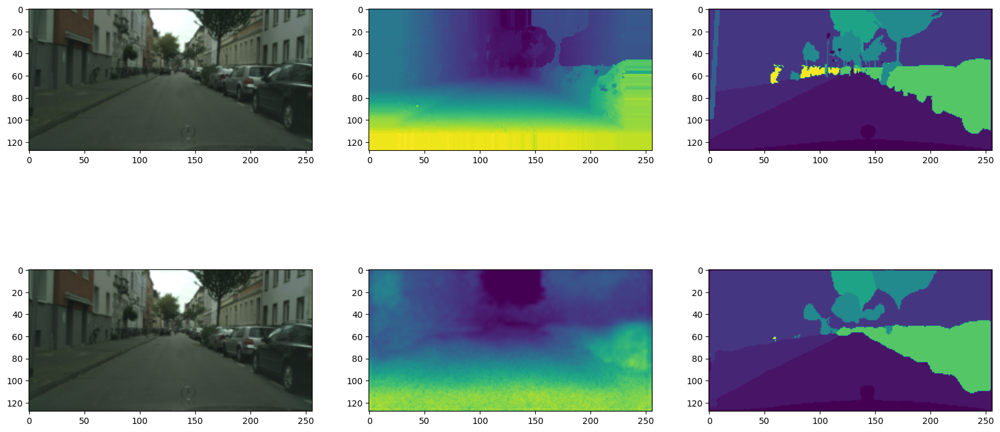

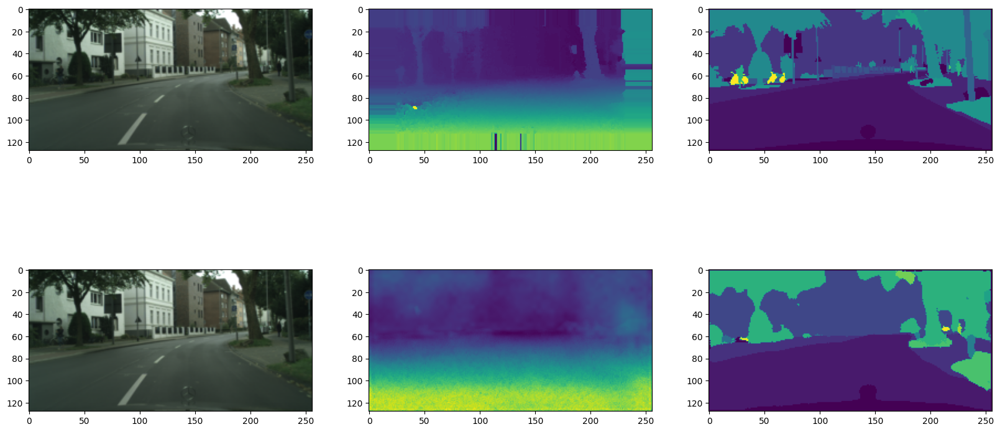

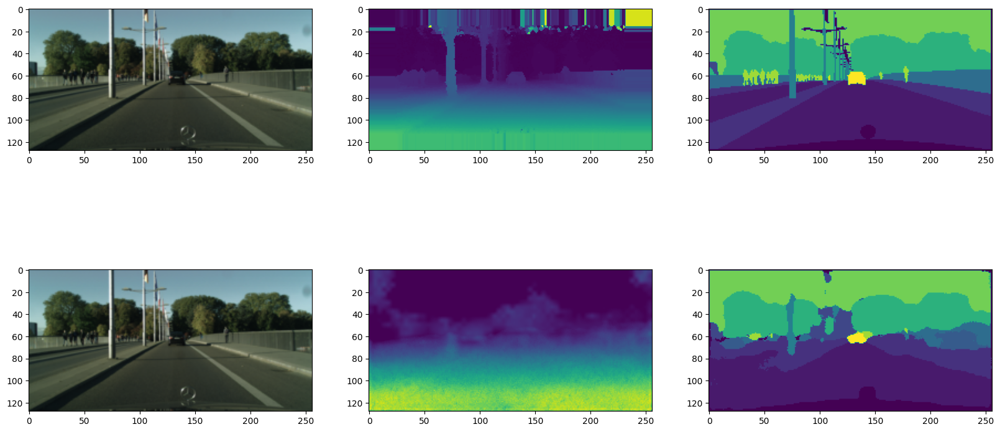

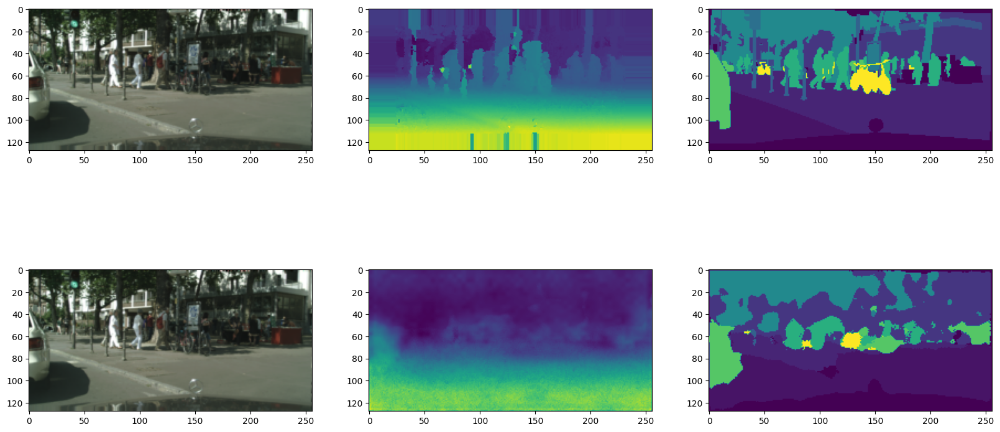

----Epoch [5] - Loss : {'loss': tensor(-176.5956, device='cuda:0'), 'loss_aux_labels': tensor(1355.9363, device='cuda:0'), 'loss_aux_depth': tensor(99.3666, device='cuda:0'), 'loss_labels': tensor(219.2265, device='cuda:0'), 'loss_depth': tensor(5.0461, device='cuda:0'), 'loss_out_labels': tensor(219.2265, device='cuda:0'), 'loss_out_depth': tensor(5.0461, device='cuda:0')} - Acc (tensor(0.4950, device='cuda:0'), tensor(0.5537, device='cuda:0'))
VALID****Epoch [5] - Loss : {'loss': tensor(34.6137, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(209.6653, device='cuda:0'), 'loss_depth': tensor(3.5640, device='cuda:0'), 'loss_out_labels': tensor(209.6653, device='cuda:0'), 'loss_out_depth': tensor(3.5640, device='cuda:0')} - Acc (tensor(0.4419, device='cuda:0'), tensor(0.7075, device='cuda:0'))


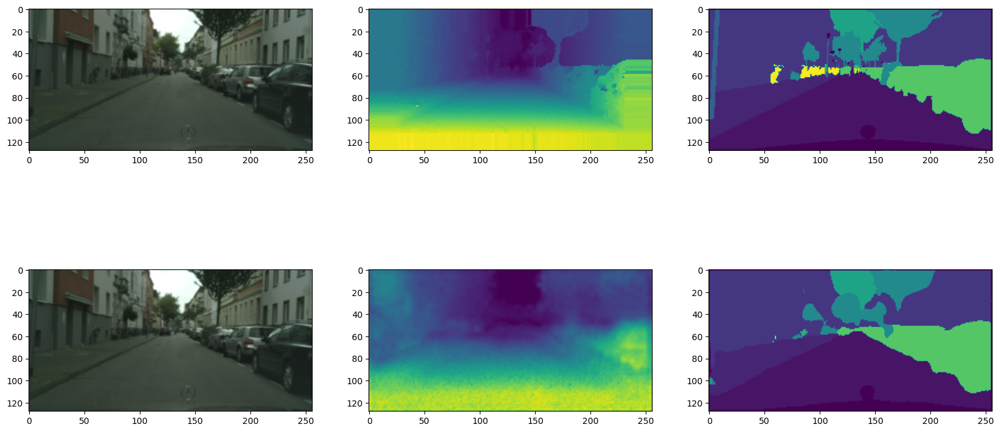

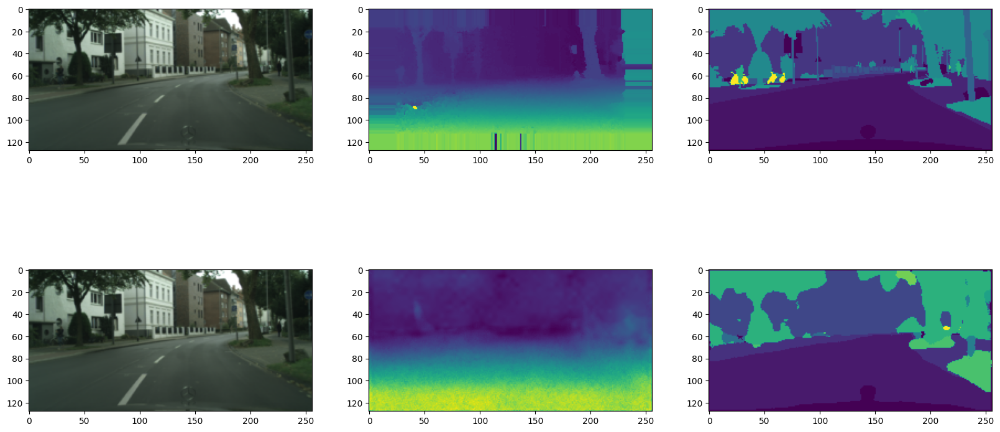

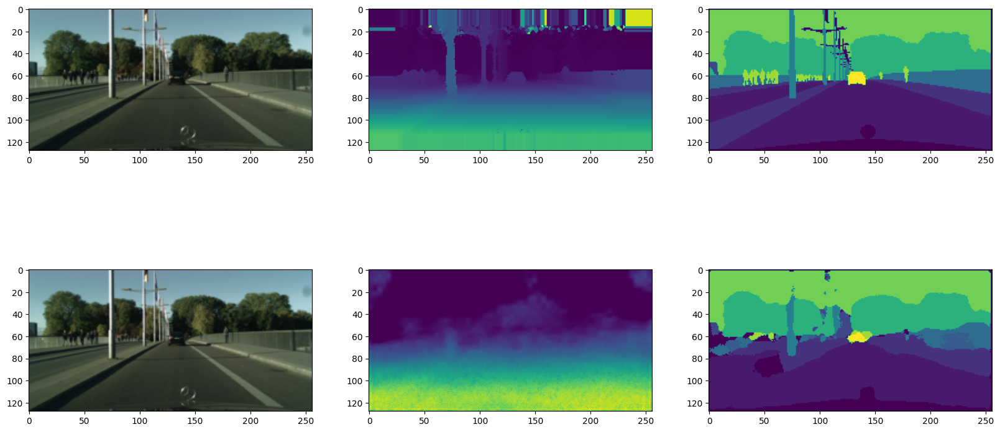

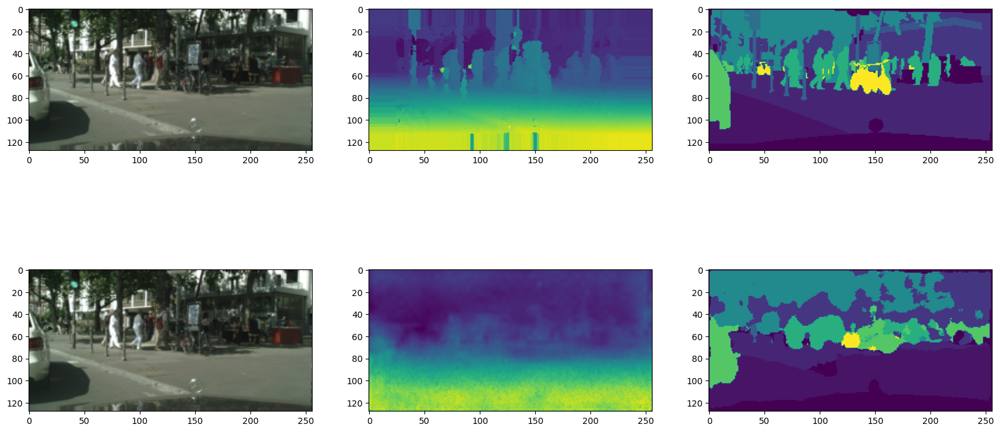

----Epoch [6] - Loss : {'loss': tensor(202.9818, device='cuda:0'), 'loss_aux_labels': tensor(1355.9349, device='cuda:0'), 'loss_aux_depth': tensor(99.3867, device='cuda:0'), 'loss_labels': tensor(217.5128, device='cuda:0'), 'loss_depth': tensor(4.7502, device='cuda:0'), 'loss_out_labels': tensor(217.5128, device='cuda:0'), 'loss_out_depth': tensor(4.7502, device='cuda:0')} - Acc (tensor(0.5028, device='cuda:0'), tensor(0.5691, device='cuda:0'))
VALID****Epoch [6] - Loss : {'loss': tensor(274.0736, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(210.0226, device='cuda:0'), 'loss_depth': tensor(3.5829, device='cuda:0'), 'loss_out_labels': tensor(210.0226, device='cuda:0'), 'loss_out_depth': tensor(3.5829, device='cuda:0')} - Acc (tensor(0.4328, device='cuda:0'), tensor(0.7042, device='cuda:0'))


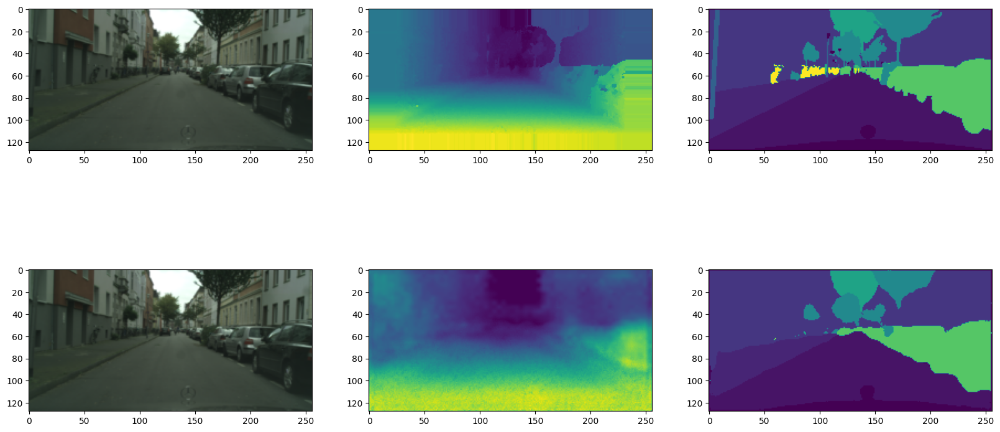

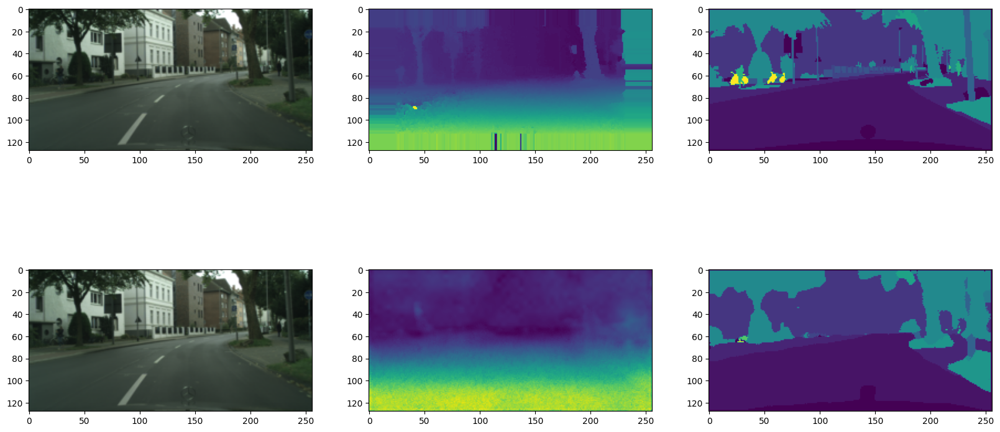

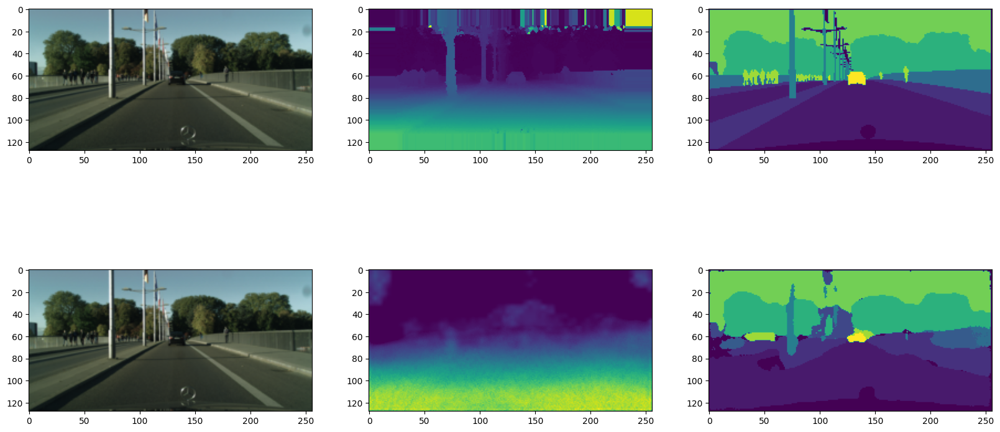

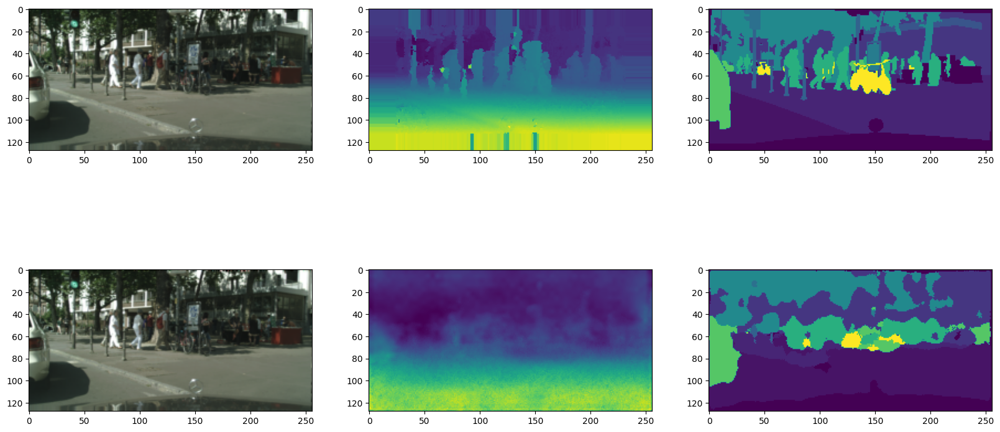

----Epoch [7] - Loss : {'loss': tensor(359.8960, device='cuda:0'), 'loss_aux_labels': tensor(1355.9453, device='cuda:0'), 'loss_aux_depth': tensor(99.3674, device='cuda:0'), 'loss_labels': tensor(224.1176, device='cuda:0'), 'loss_depth': tensor(4.7439, device='cuda:0'), 'loss_out_labels': tensor(224.1176, device='cuda:0'), 'loss_out_depth': tensor(4.7439, device='cuda:0')} - Acc (tensor(0.4891, device='cuda:0'), tensor(0.5751, device='cuda:0'))
VALID****Epoch [7] - Loss : {'loss': tensor(393.7293, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(218.0105, device='cuda:0'), 'loss_depth': tensor(3.5222, device='cuda:0'), 'loss_out_labels': tensor(218.0105, device='cuda:0'), 'loss_out_depth': tensor(3.5222, device='cuda:0')} - Acc (tensor(0.4350, device='cuda:0'), tensor(0.7096, device='cuda:0'))


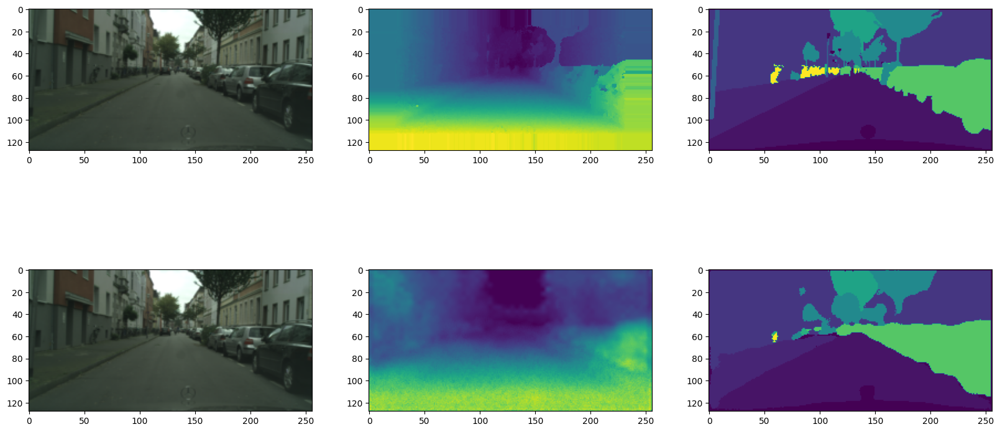

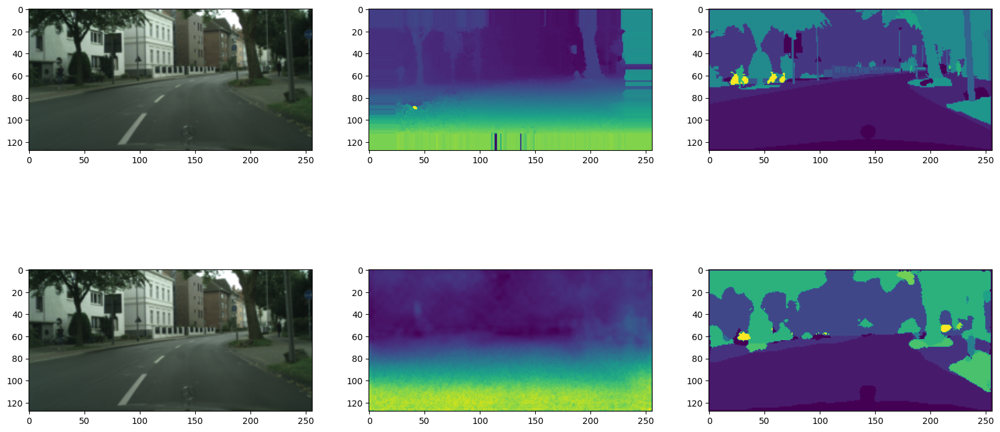

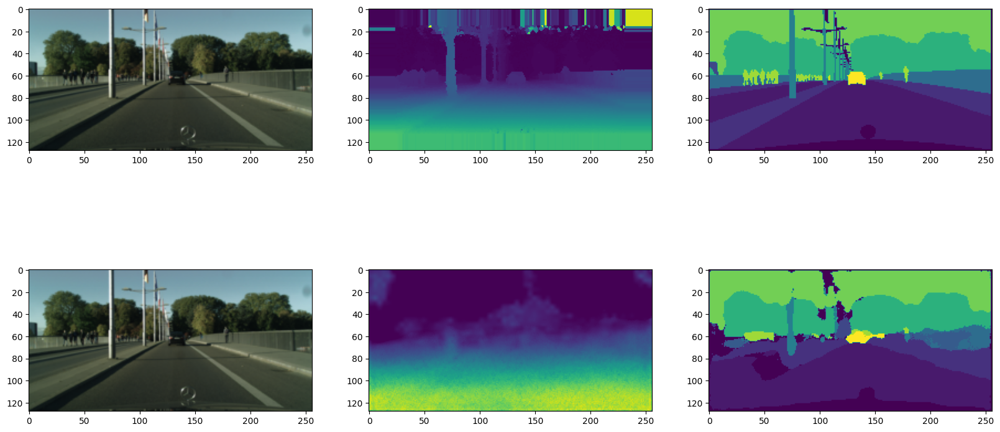

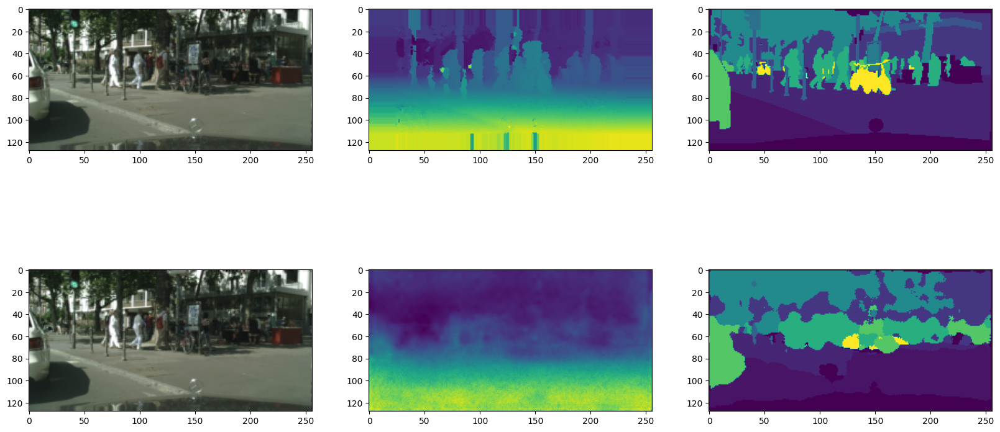

----Epoch [8] - Loss : {'loss': tensor(481.9396, device='cuda:0'), 'loss_aux_labels': tensor(1355.9397, device='cuda:0'), 'loss_aux_depth': tensor(99.3755, device='cuda:0'), 'loss_labels': tensor(226.7797, device='cuda:0'), 'loss_depth': tensor(4.7279, device='cuda:0'), 'loss_out_labels': tensor(226.7797, device='cuda:0'), 'loss_out_depth': tensor(4.7279, device='cuda:0')} - Acc (tensor(0.4781, device='cuda:0'), tensor(0.5823, device='cuda:0'))
VALID****Epoch [8] - Loss : {'loss': tensor(423.2219, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(203.1522, device='cuda:0'), 'loss_depth': tensor(3.5081, device='cuda:0'), 'loss_out_labels': tensor(203.1522, device='cuda:0'), 'loss_out_depth': tensor(3.5081, device='cuda:0')} - Acc (tensor(0.4431, device='cuda:0'), tensor(0.7114, device='cuda:0'))


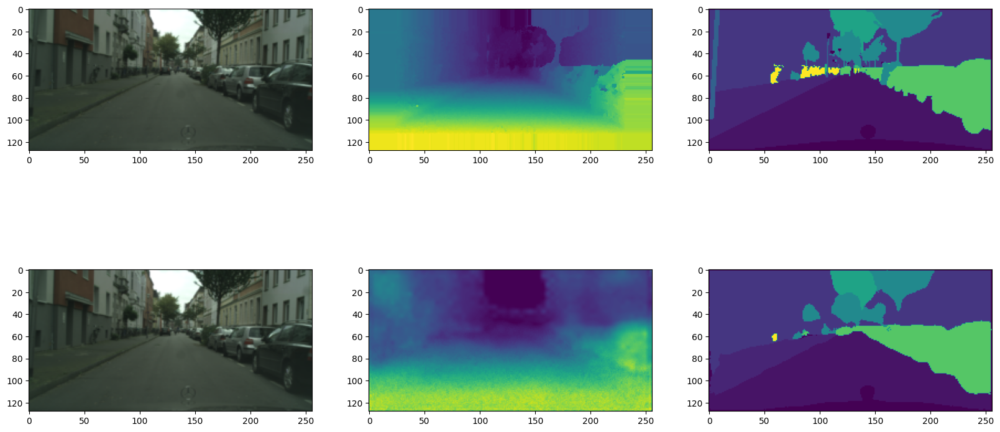

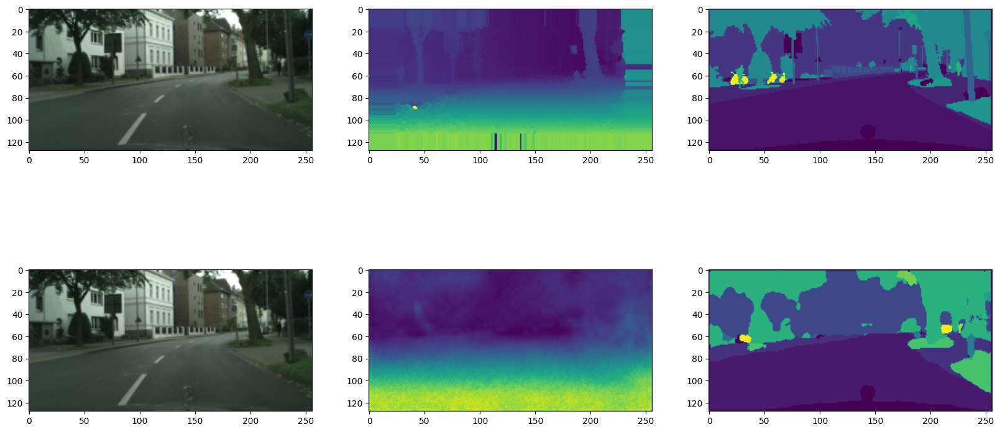

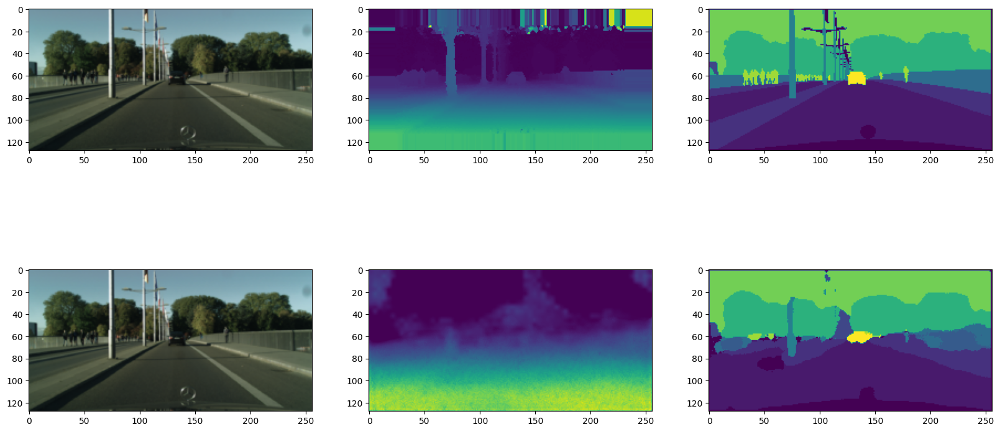

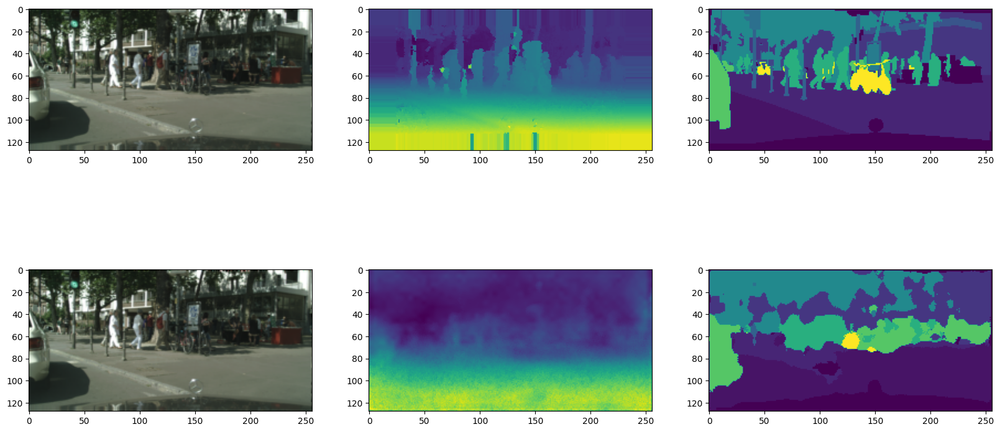

In [28]:
train_model(model,adp,n_epoch)

In [29]:
# Fine Tuning 
from pytorch_msssim import ssim, ms_ssim, SSIM, MS_SSIM

model.unfreeze()
opt = torch.optim.Adam(params=model.parameters(),lr=tuned_lr,weight_decay=0.00001)
loss_opt = torch.optim.Adam(params=adp.parameters(),lr=tuned_lr)
lossFn = torch.nn.CrossEntropyLoss()
ssim = SSIM(data_range=1,channel=1,size_average=True)
lossFn_depth = torch.nn.MSELoss()

----Epoch [9] - Loss : {'loss': tensor(512.8111, device='cuda:0'), 'loss_aux_labels': tensor(1357.4507, device='cuda:0'), 'loss_aux_depth': tensor(98.1593, device='cuda:0'), 'loss_labels': tensor(198.7582, device='cuda:0'), 'loss_depth': tensor(4.4492, device='cuda:0'), 'loss_out_labels': tensor(198.7582, device='cuda:0'), 'loss_out_depth': tensor(4.4492, device='cuda:0')} - Acc (tensor(0.5408, device='cuda:0'), tensor(0.5711, device='cuda:0'))
VALID****Epoch [9] - Loss : {'loss': tensor(479.2622, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(185.8356, device='cuda:0'), 'loss_depth': tensor(3.4628, device='cuda:0'), 'loss_out_labels': tensor(185.8356, device='cuda:0'), 'loss_out_depth': tensor(3.4628, device='cuda:0')} - Acc (tensor(0.5036, device='cuda:0'), tensor(0.7285, device='cuda:0'))


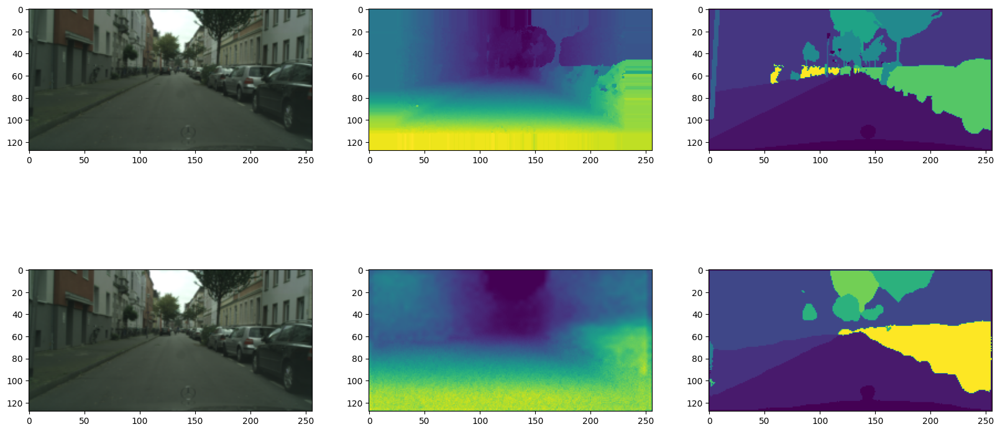

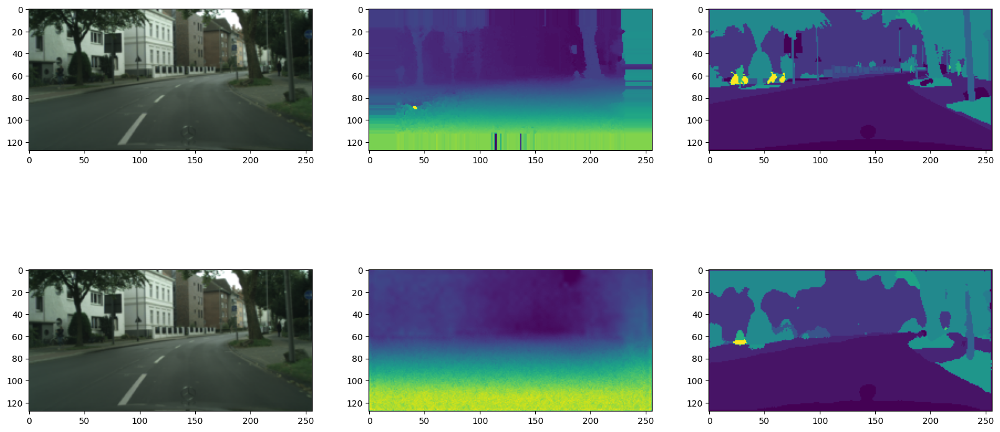

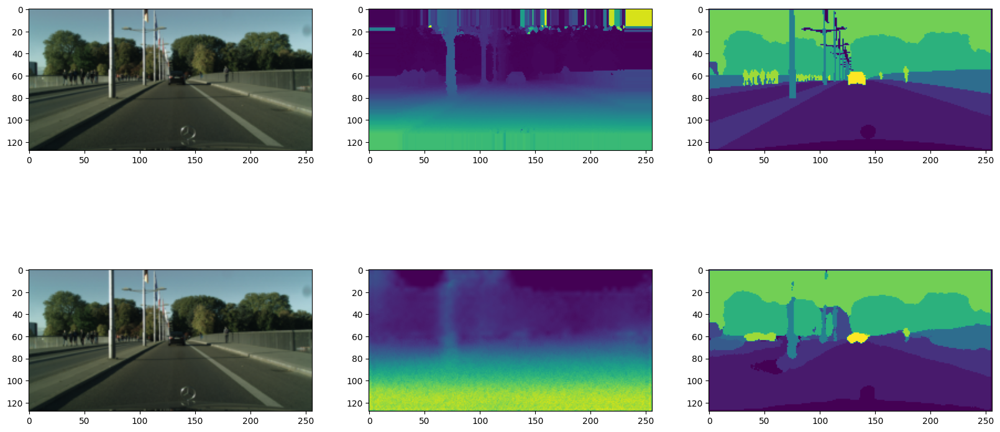

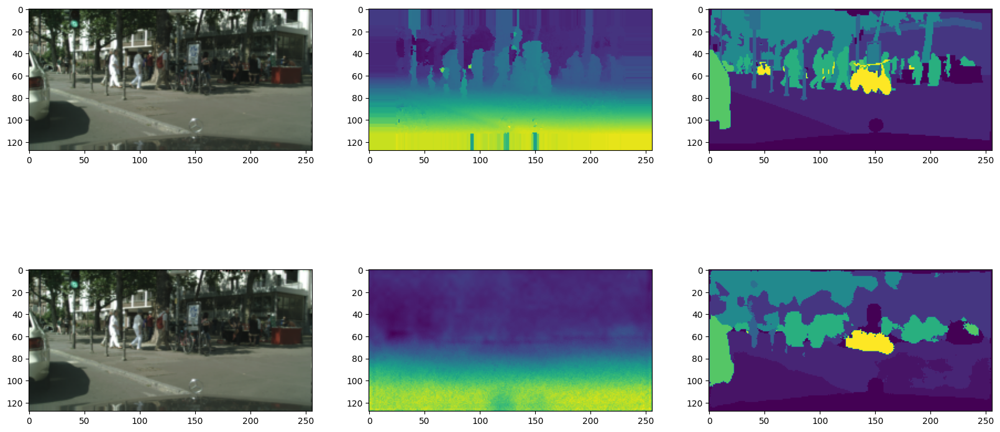

----Epoch [10] - Loss : {'loss': tensor(558.7098, device='cuda:0'), 'loss_aux_labels': tensor(1356.9116, device='cuda:0'), 'loss_aux_depth': tensor(95.5929, device='cuda:0'), 'loss_labels': tensor(164.8602, device='cuda:0'), 'loss_depth': tensor(4.5791, device='cuda:0'), 'loss_out_labels': tensor(164.8602, device='cuda:0'), 'loss_out_depth': tensor(4.5791, device='cuda:0')} - Acc (tensor(0.6194, device='cuda:0'), tensor(0.6242, device='cuda:0'))
VALID****Epoch [10] - Loss : {'loss': tensor(503.3551, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(183.2014, device='cuda:0'), 'loss_depth': tensor(7.1929, device='cuda:0'), 'loss_out_labels': tensor(183.2014, device='cuda:0'), 'loss_out_depth': tensor(7.1929, device='cuda:0')} - Acc (tensor(0.4943, device='cuda:0'), tensor(0.6623, device='cuda:0'))


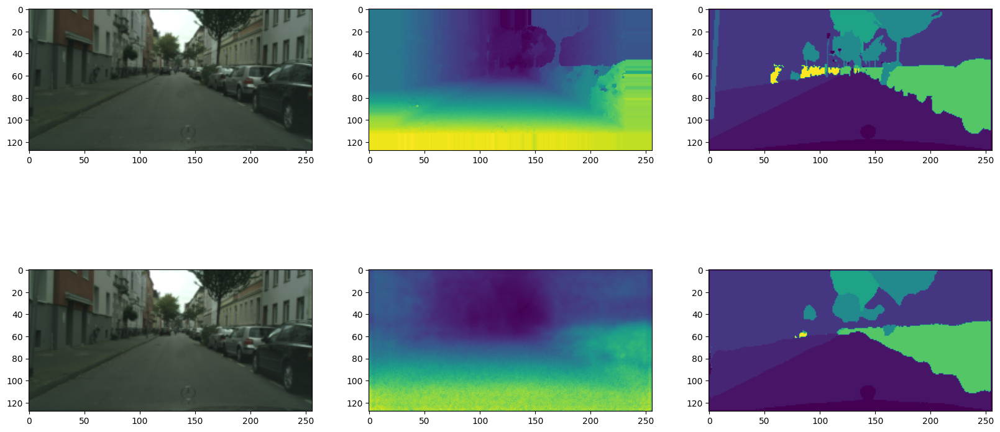

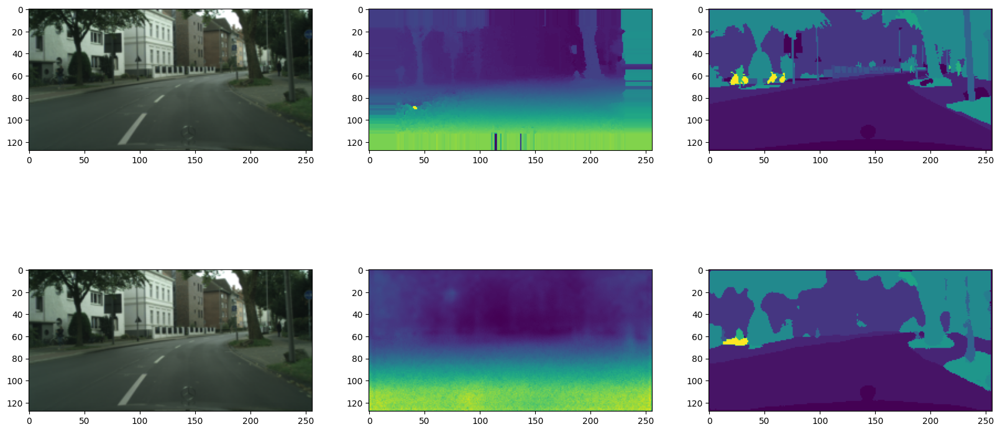

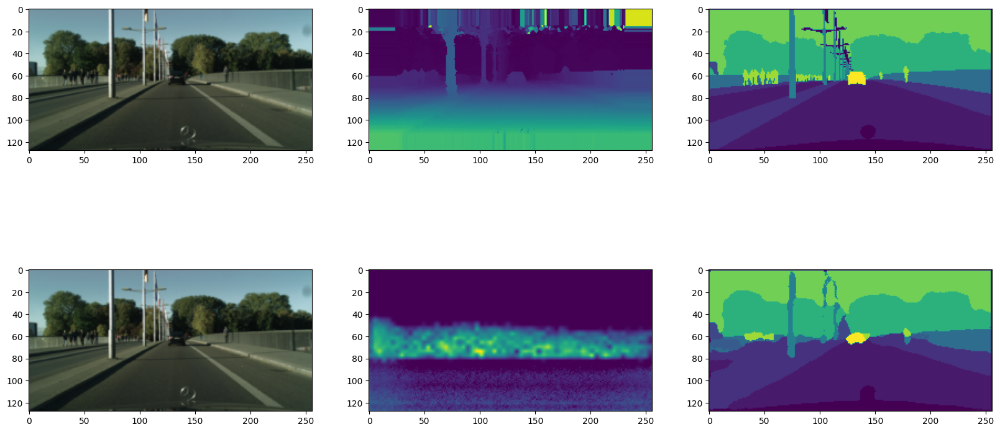

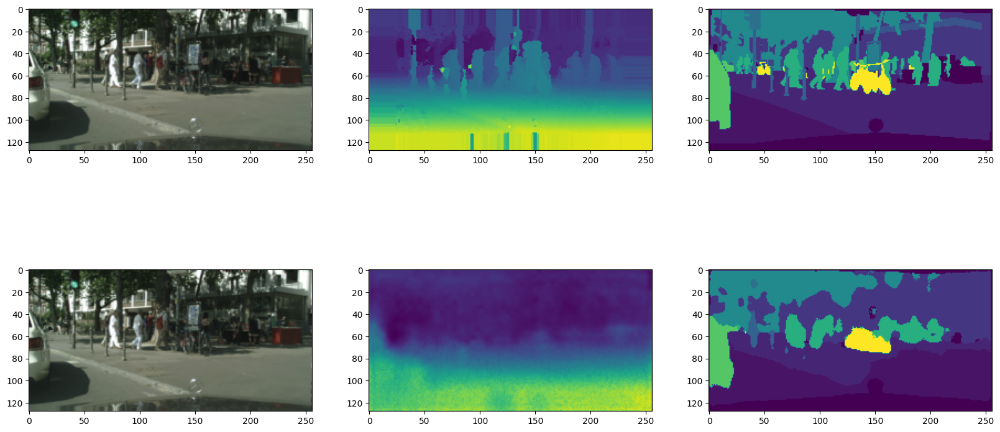

----Epoch [11] - Loss : {'loss': tensor(557.0978, device='cuda:0'), 'loss_aux_labels': tensor(1357.0896, device='cuda:0'), 'loss_aux_depth': tensor(96.5073, device='cuda:0'), 'loss_labels': tensor(171.3069, device='cuda:0'), 'loss_depth': tensor(4.7774, device='cuda:0'), 'loss_out_labels': tensor(171.3069, device='cuda:0'), 'loss_out_depth': tensor(4.7774, device='cuda:0')} - Acc (tensor(0.6011, device='cuda:0'), tensor(0.6607, device='cuda:0'))
VALID****Epoch [11] - Loss : {'loss': tensor(606.5657, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(213.9227, device='cuda:0'), 'loss_depth': tensor(4.2011, device='cuda:0'), 'loss_out_labels': tensor(213.9227, device='cuda:0'), 'loss_out_depth': tensor(4.2011, device='cuda:0')} - Acc (tensor(0.4832, device='cuda:0'), tensor(0.6922, device='cuda:0'))


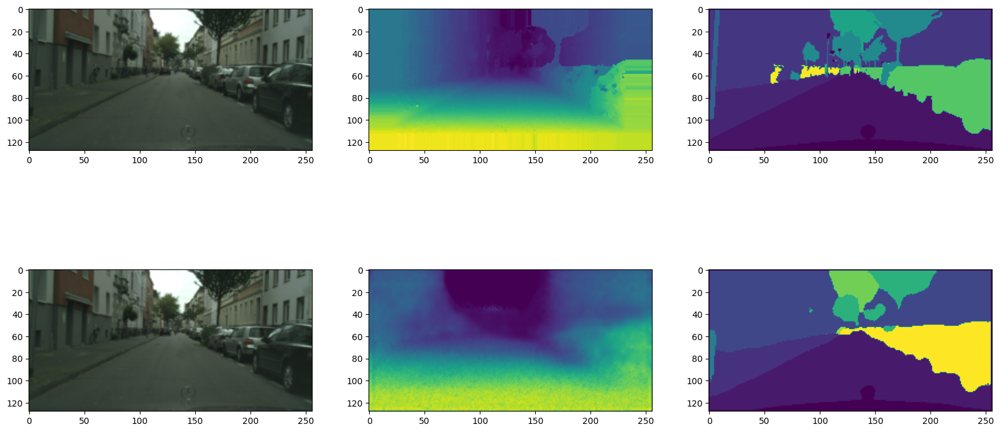

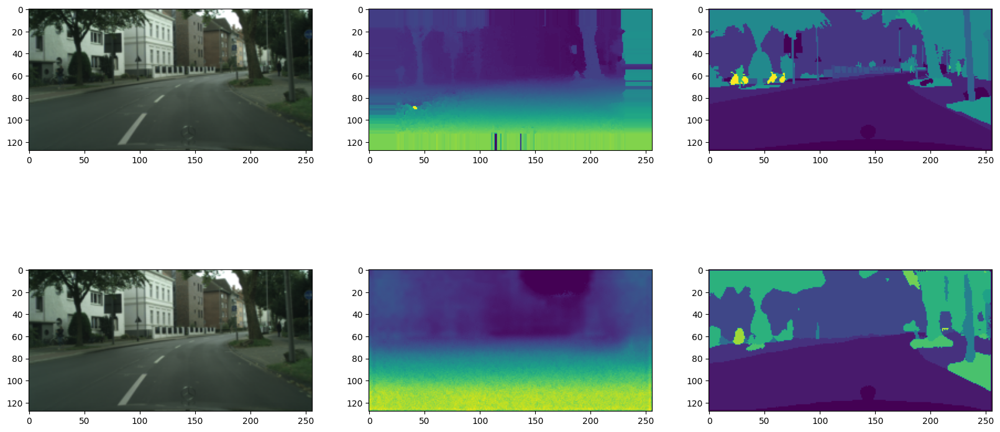

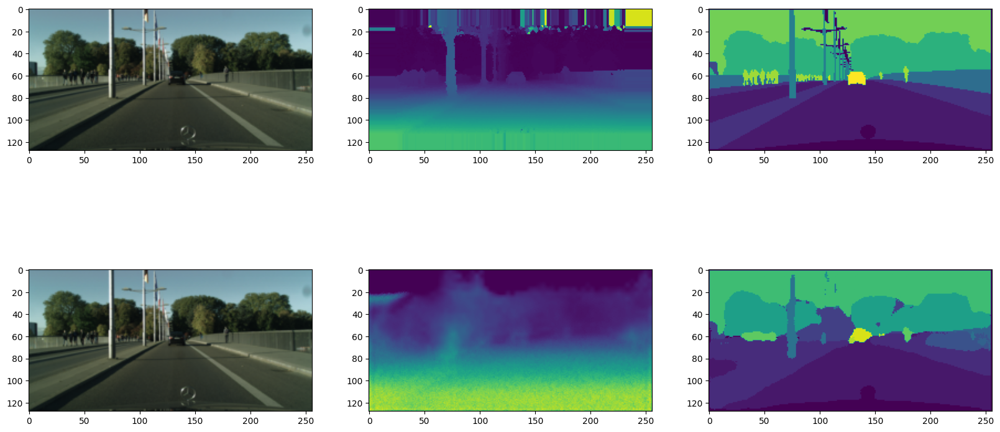

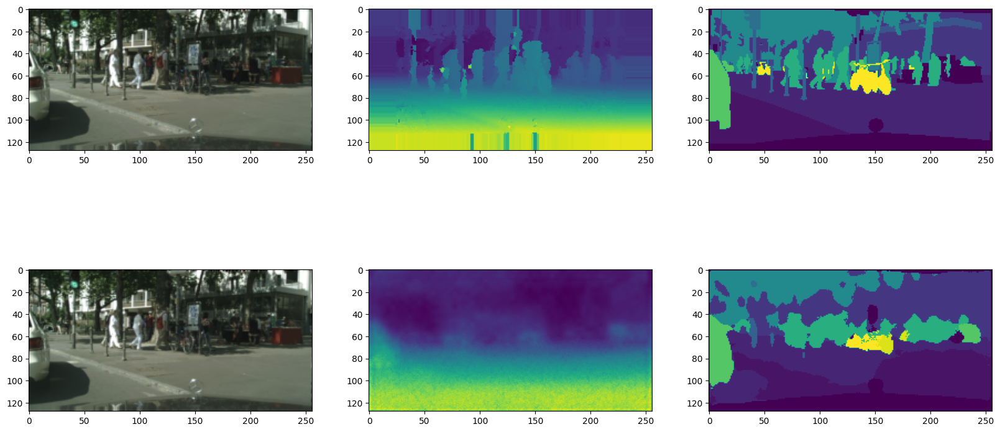

----Epoch [12] - Loss : {'loss': tensor(547.9880, device='cuda:0'), 'loss_aux_labels': tensor(1357.0819, device='cuda:0'), 'loss_aux_depth': tensor(96.7769, device='cuda:0'), 'loss_labels': tensor(162.2766, device='cuda:0'), 'loss_depth': tensor(4.6345, device='cuda:0'), 'loss_out_labels': tensor(162.2766, device='cuda:0'), 'loss_out_depth': tensor(4.6345, device='cuda:0')} - Acc (tensor(0.6252, device='cuda:0'), tensor(0.6287, device='cuda:0'))
VALID****Epoch [12] - Loss : {'loss': tensor(478.4115, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(171.2474, device='cuda:0'), 'loss_depth': tensor(3.5774, device='cuda:0'), 'loss_out_labels': tensor(171.2474, device='cuda:0'), 'loss_out_depth': tensor(3.5774, device='cuda:0')} - Acc (tensor(0.5049, device='cuda:0'), tensor(0.7458, device='cuda:0'))


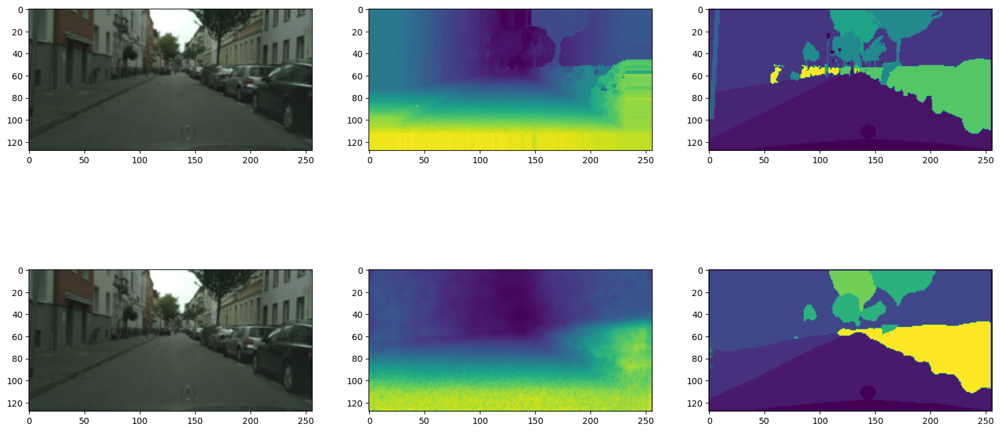

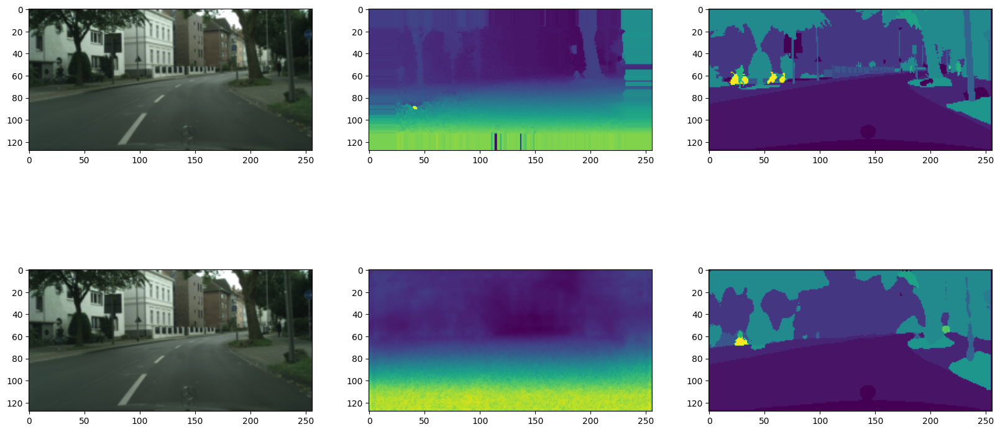

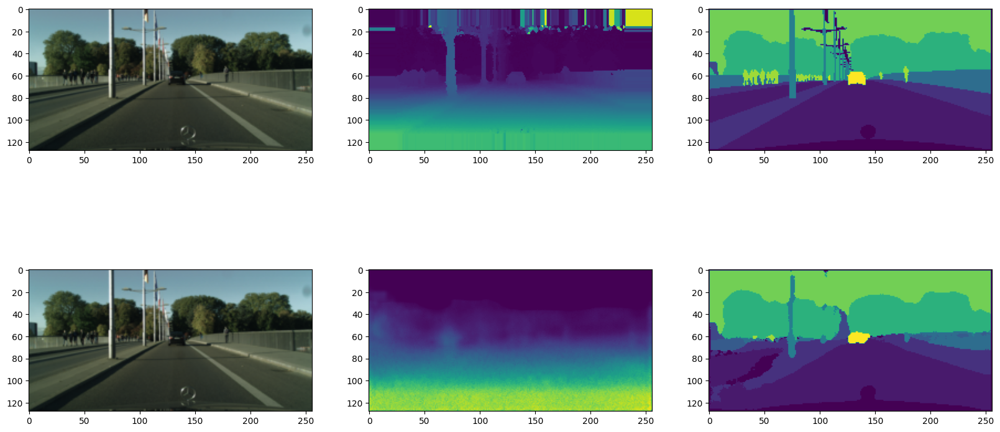

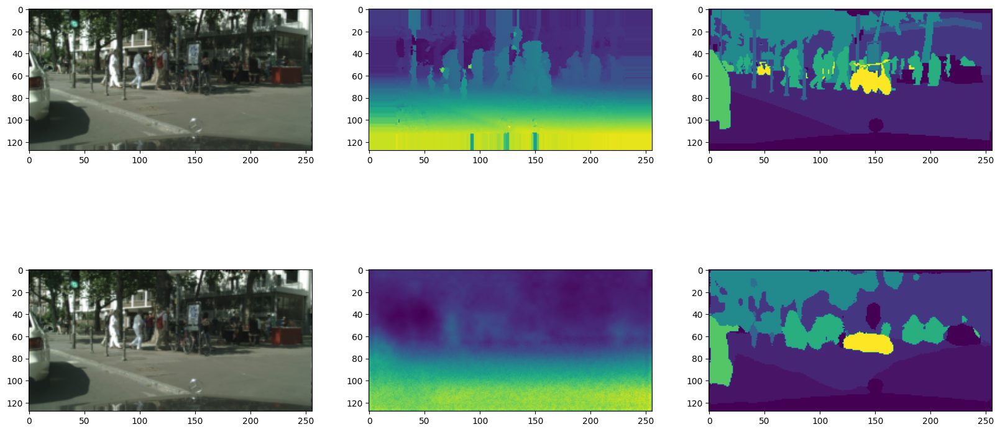

----Epoch [13] - Loss : {'loss': tensor(443.0384, device='cuda:0'), 'loss_aux_labels': tensor(1357.1049, device='cuda:0'), 'loss_aux_depth': tensor(100.2372, device='cuda:0'), 'loss_labels': tensor(129.6946, device='cuda:0'), 'loss_depth': tensor(4.6222, device='cuda:0'), 'loss_out_labels': tensor(129.6946, device='cuda:0'), 'loss_out_depth': tensor(4.6222, device='cuda:0')} - Acc (tensor(0.7010, device='cuda:0'), tensor(0.6321, device='cuda:0'))
VALID****Epoch [13] - Loss : {'loss': tensor(396.5304, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(168.3055, device='cuda:0'), 'loss_depth': tensor(8.1521, device='cuda:0'), 'loss_out_labels': tensor(168.3055, device='cuda:0'), 'loss_out_depth': tensor(8.1521, device='cuda:0')} - Acc (tensor(0.5353, device='cuda:0'), tensor(0.6622, device='cuda:0'))


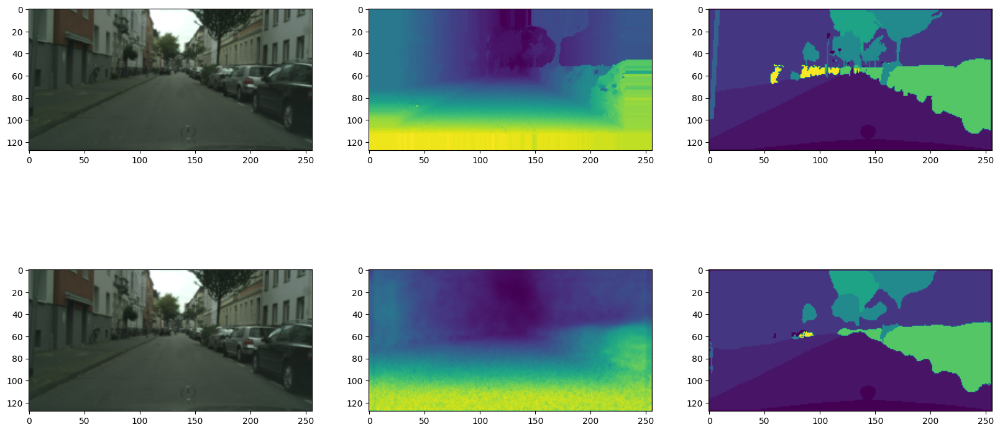

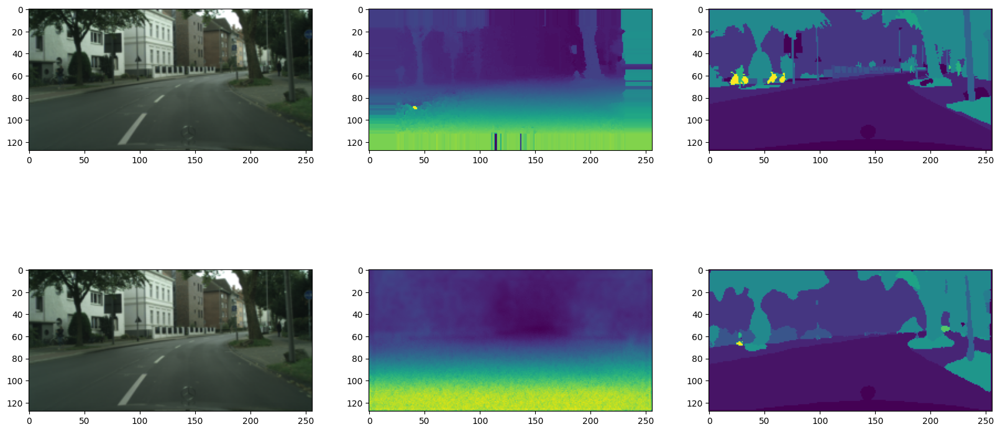

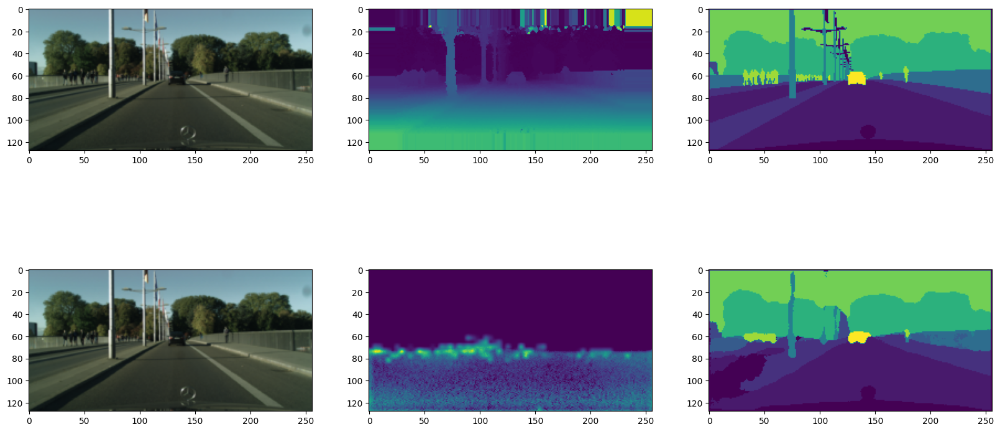

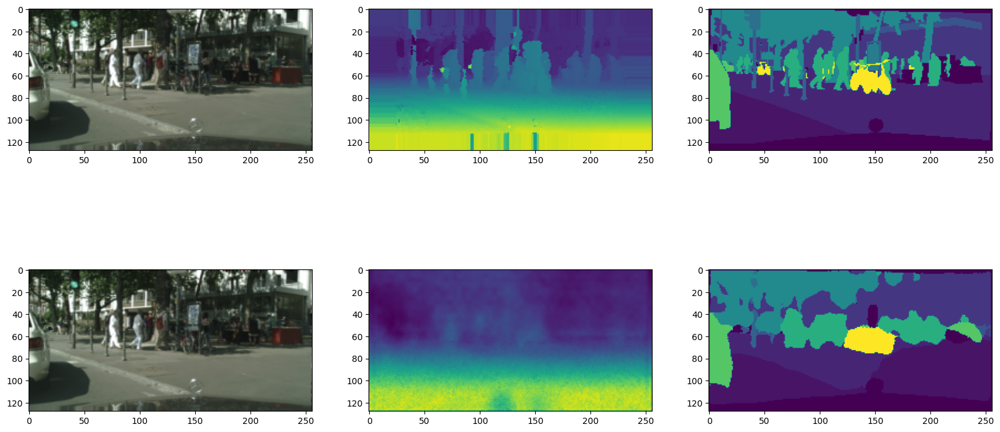

----Epoch [14] - Loss : {'loss': tensor(310.2304, device='cuda:0'), 'loss_aux_labels': tensor(1356.1689, device='cuda:0'), 'loss_aux_depth': tensor(101.5548, device='cuda:0'), 'loss_labels': tensor(121.7063, device='cuda:0'), 'loss_depth': tensor(4.5958, device='cuda:0'), 'loss_out_labels': tensor(121.7063, device='cuda:0'), 'loss_out_depth': tensor(4.5958, device='cuda:0')} - Acc (tensor(0.7167, device='cuda:0'), tensor(0.6228, device='cuda:0'))
VALID****Epoch [14] - Loss : {'loss': tensor(338.4451, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(191.5817, device='cuda:0'), 'loss_depth': tensor(3.8238, device='cuda:0'), 'loss_out_labels': tensor(191.5817, device='cuda:0'), 'loss_out_depth': tensor(3.8238, device='cuda:0')} - Acc (tensor(0.5023, device='cuda:0'), tensor(0.7408, device='cuda:0'))


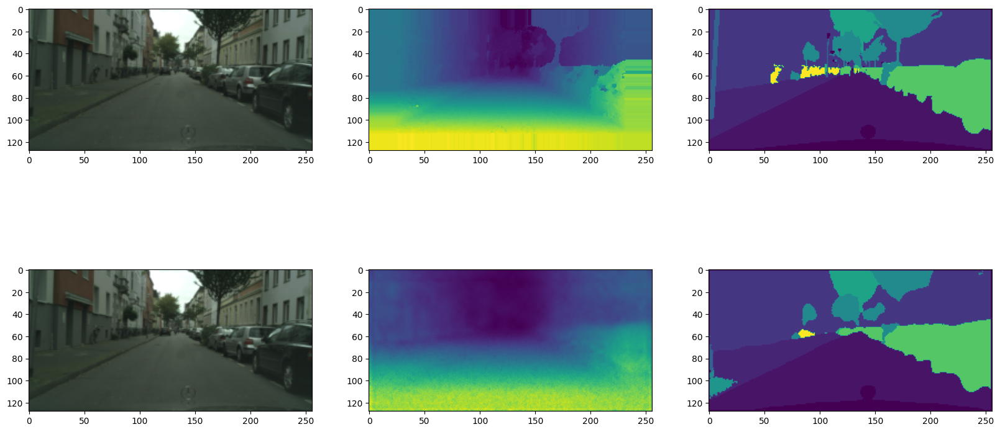

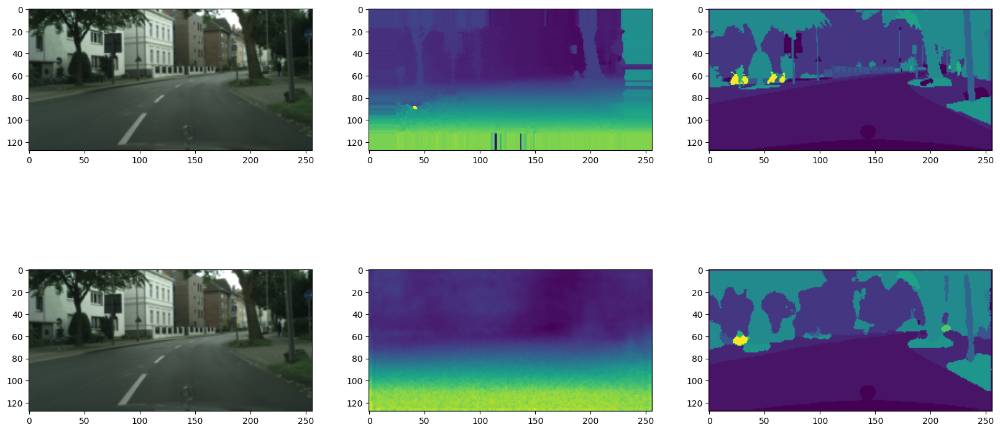

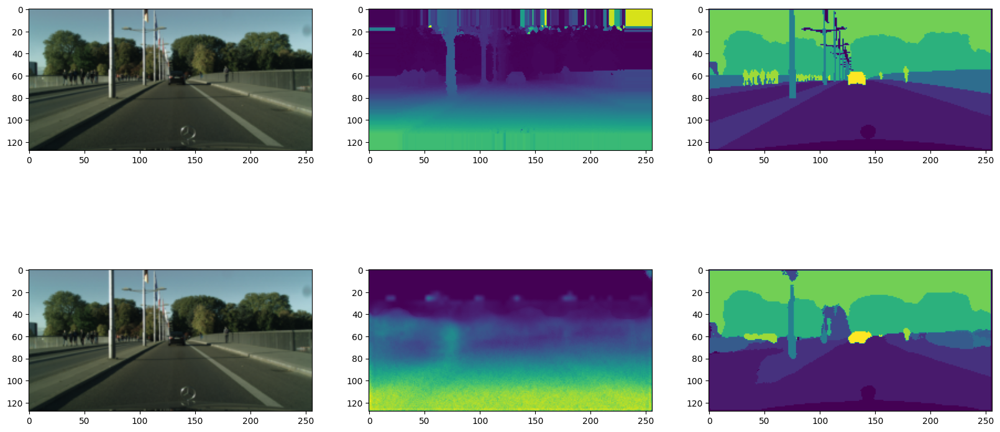

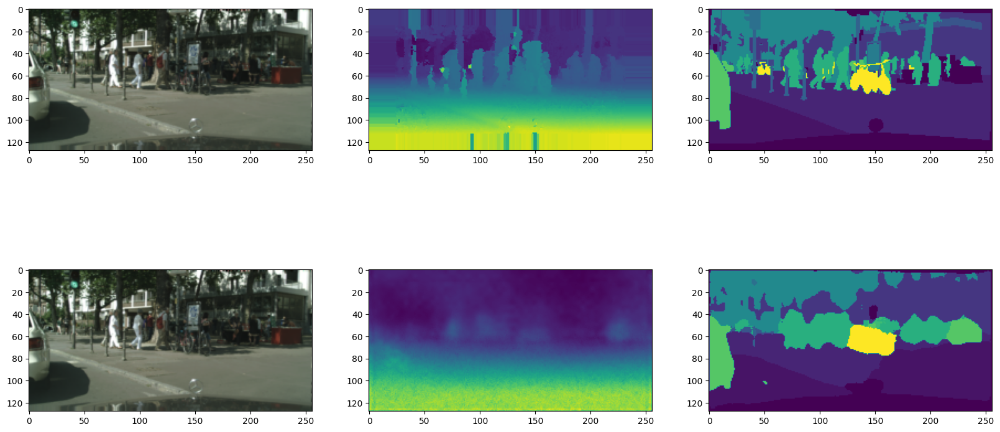

----Epoch [15] - Loss : {'loss': tensor(182.7311, device='cuda:0'), 'loss_aux_labels': tensor(1356.8463, device='cuda:0'), 'loss_aux_depth': tensor(101.6098, device='cuda:0'), 'loss_labels': tensor(152.9444, device='cuda:0'), 'loss_depth': tensor(4.5403, device='cuda:0'), 'loss_out_labels': tensor(152.9444, device='cuda:0'), 'loss_out_depth': tensor(4.5403, device='cuda:0')} - Acc (tensor(0.6434, device='cuda:0'), tensor(0.6029, device='cuda:0'))
VALID****Epoch [15] - Loss : {'loss': tensor(90.9939, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(173.1364, device='cuda:0'), 'loss_depth': tensor(3.7918, device='cuda:0'), 'loss_out_labels': tensor(173.1364, device='cuda:0'), 'loss_out_depth': tensor(3.7918, device='cuda:0')} - Acc (tensor(0.5327, device='cuda:0'), tensor(0.7372, device='cuda:0'))


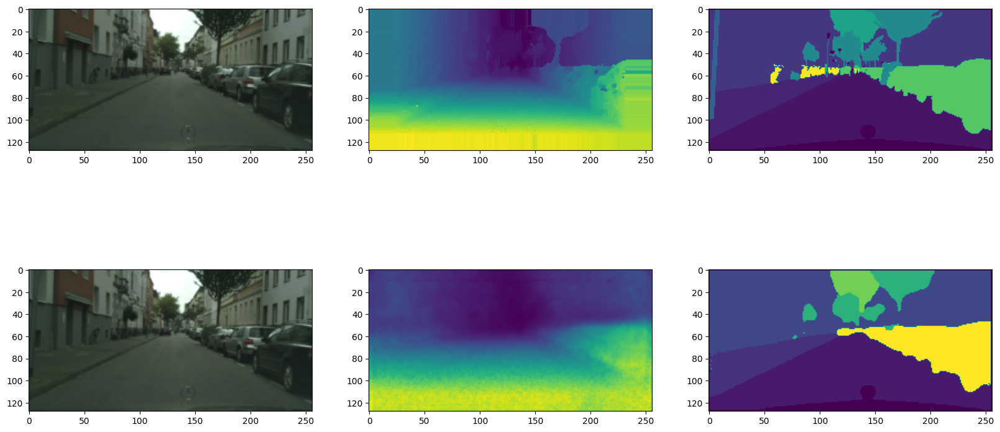

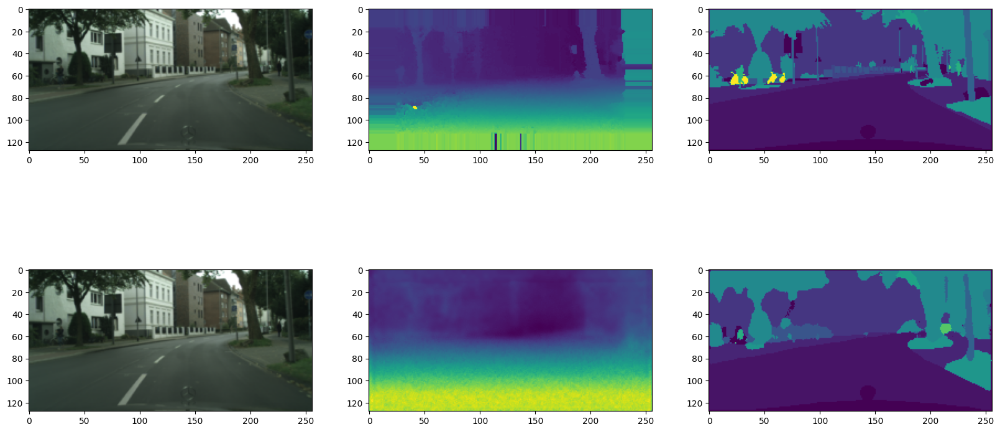

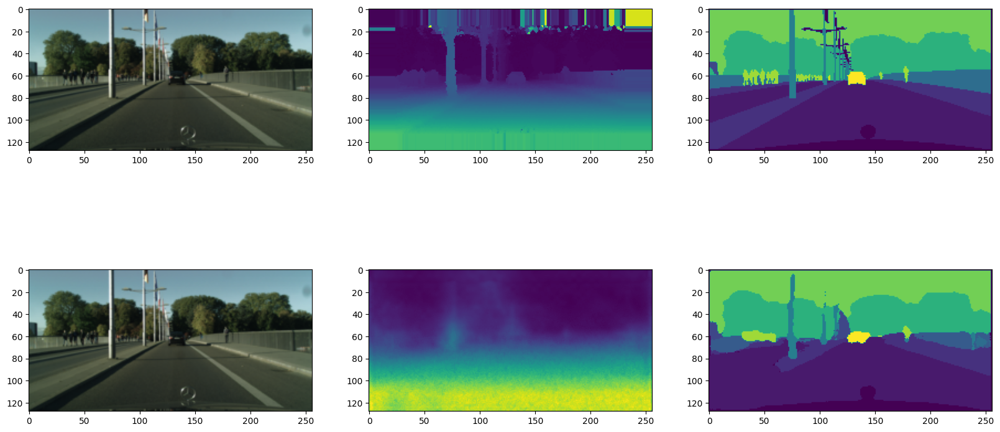

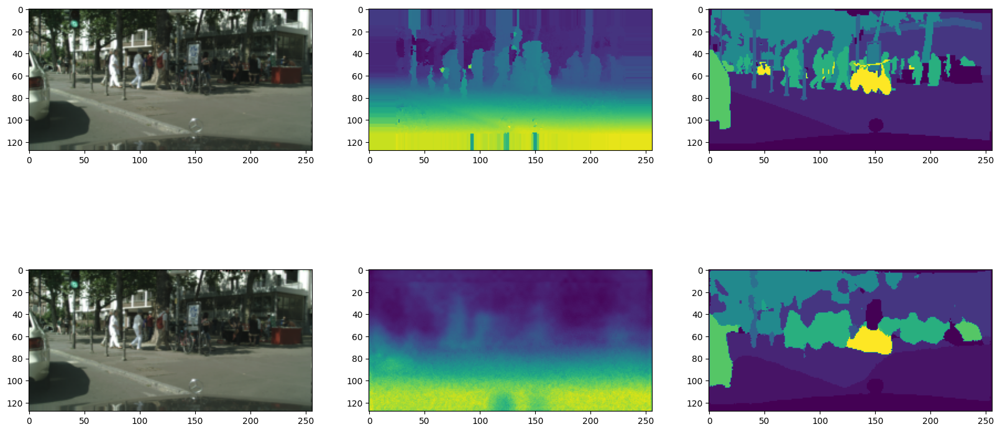

----Epoch [16] - Loss : {'loss': tensor(-195.5060, device='cuda:0'), 'loss_aux_labels': tensor(1356.9121, device='cuda:0'), 'loss_aux_depth': tensor(101.6675, device='cuda:0'), 'loss_labels': tensor(118.1325, device='cuda:0'), 'loss_depth': tensor(4.2873, device='cuda:0'), 'loss_out_labels': tensor(118.1325, device='cuda:0'), 'loss_out_depth': tensor(4.2873, device='cuda:0')} - Acc (tensor(0.7256, device='cuda:0'), tensor(0.6118, device='cuda:0'))
VALID****Epoch [16] - Loss : {'loss': tensor(-304.3593, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(180.6805, device='cuda:0'), 'loss_depth': tensor(3.8528, device='cuda:0'), 'loss_out_labels': tensor(180.6805, device='cuda:0'), 'loss_out_depth': tensor(3.8528, device='cuda:0')} - Acc (tensor(0.5331, device='cuda:0'), tensor(0.7467, device='cuda:0'))


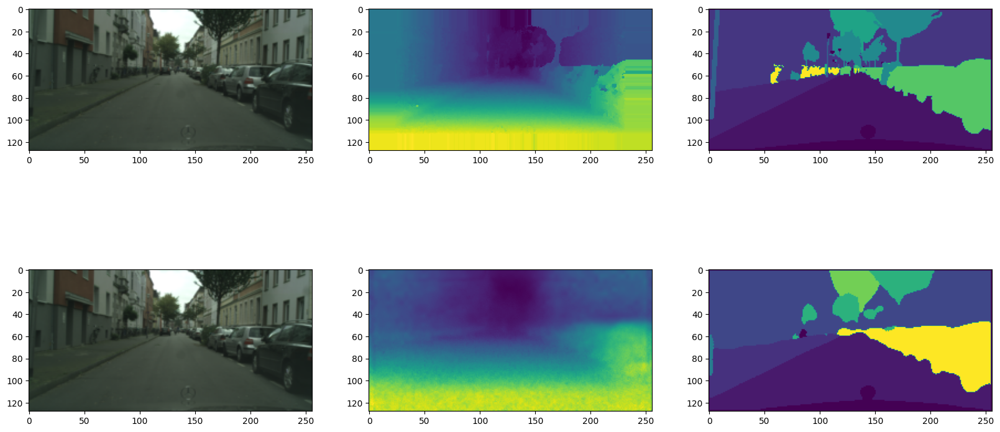

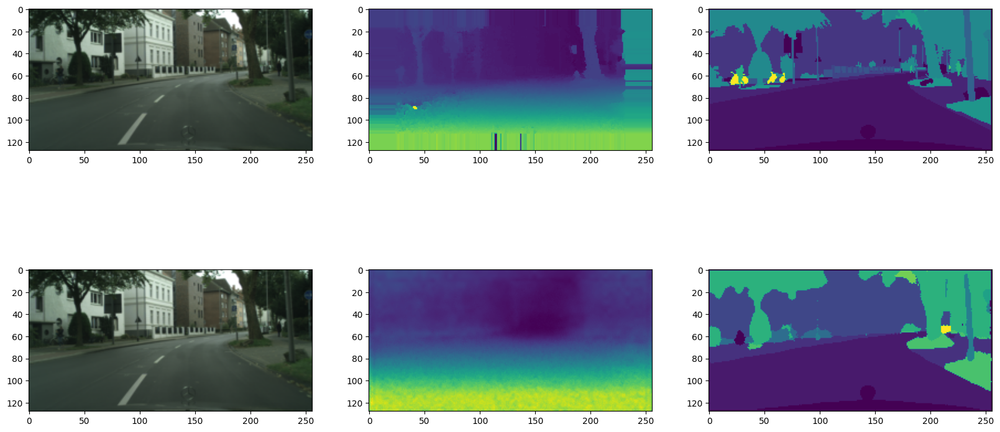

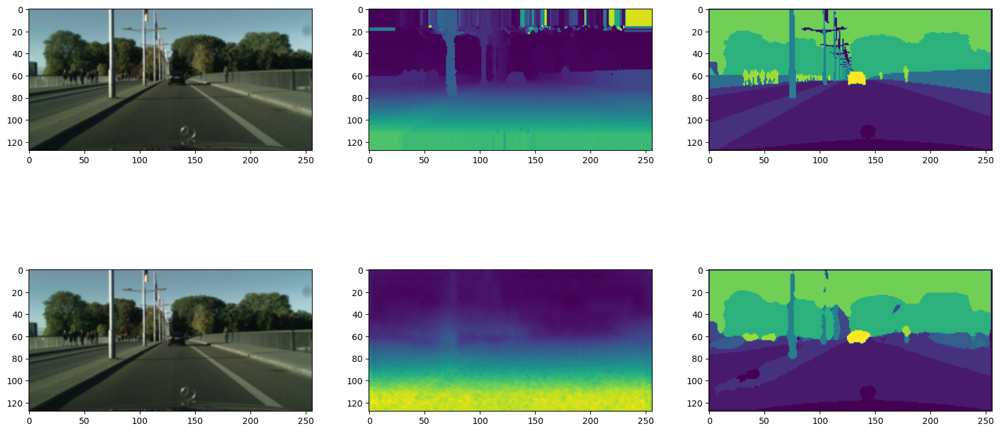

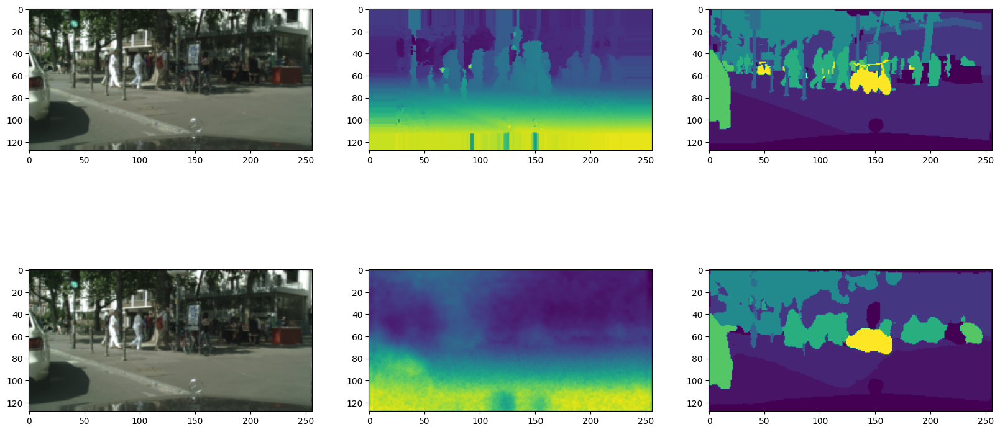

----Epoch [17] - Loss : {'loss': tensor(-380.8801, device='cuda:0'), 'loss_aux_labels': tensor(1356.7163, device='cuda:0'), 'loss_aux_depth': tensor(101.2862, device='cuda:0'), 'loss_labels': tensor(110.0286, device='cuda:0'), 'loss_depth': tensor(4.1696, device='cuda:0'), 'loss_out_labels': tensor(110.0286, device='cuda:0'), 'loss_out_depth': tensor(4.1696, device='cuda:0')} - Acc (tensor(0.7434, device='cuda:0'), tensor(0.6231, device='cuda:0'))
VALID****Epoch [17] - Loss : {'loss': tensor(-76.0036, device='cuda:0'), 'loss_aux_labels': 0, 'loss_aux_depth': 0, 'loss_labels': tensor(187.6976, device='cuda:0'), 'loss_depth': tensor(3.3156, device='cuda:0'), 'loss_out_labels': tensor(187.6976, device='cuda:0'), 'loss_out_depth': tensor(3.3156, device='cuda:0')} - Acc (tensor(0.5426, device='cuda:0'), tensor(0.7629, device='cuda:0'))


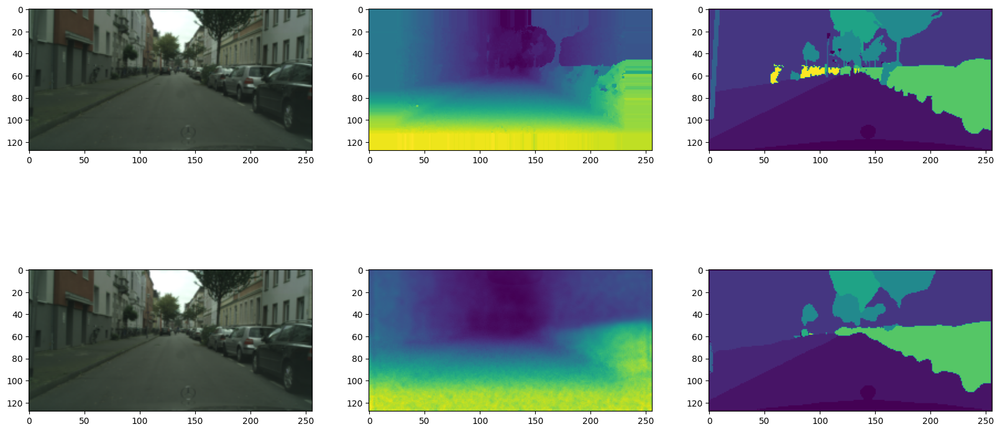

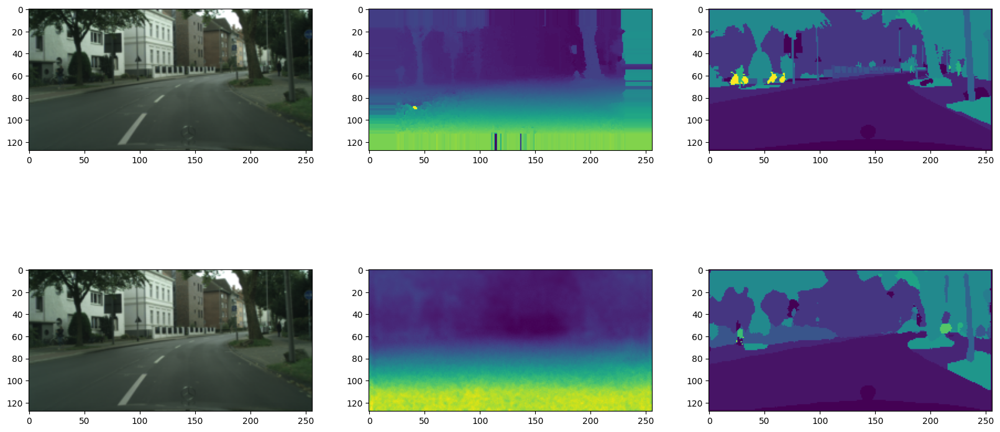

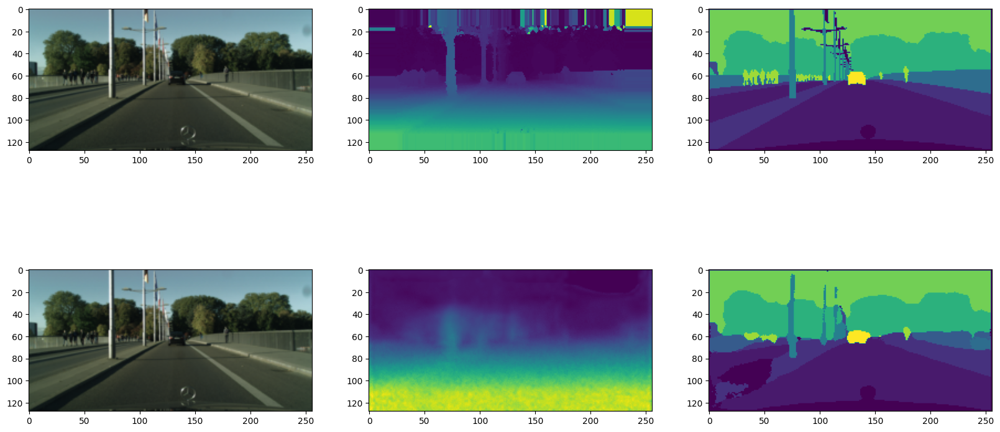

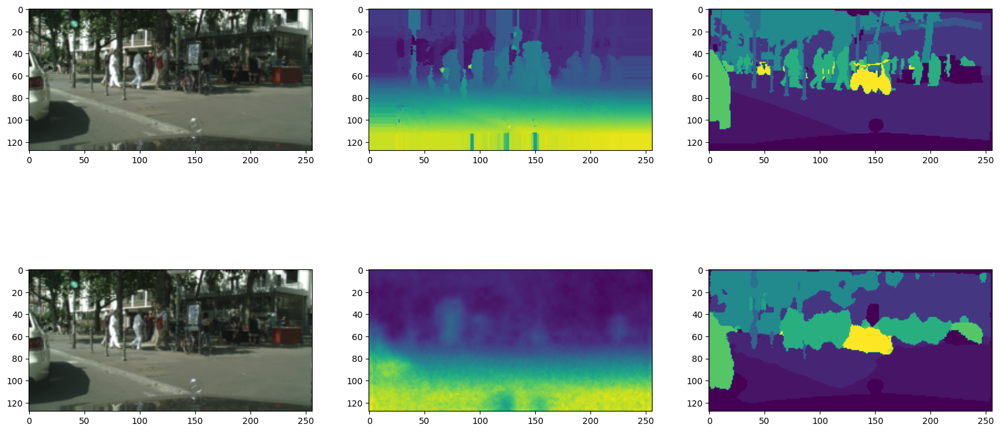

In [30]:
train_model(model,adp,tuned_epoch,n_epoch)

In [31]:
wandb.finish()

wandb:                                                                                
wandb: 
wandb: Run history:
wandb:                 epoch ▁▁▁▁▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇████
wandb:  train_depth_accuracy ▄▂▁▁▂▂▃▄▄▃▆█▆▇▆▅▅▆
wandb: train_labels_accuracy ▁▂▃▃▃▄▄▄▃▄▆▆▆▇█▆██
wandb:            train_loss ▅▃▅▅▄▃▅▇▇████▇▆▅▂▁
wandb:  train_loss_aux_depth ▅▅▅▅▅▅▅▅▅▄▁▂▂▆████
wandb: train_loss_aux_labels ▁▁▁▂▁▁▁▁▁█▆▆▆▆▂▅▆▅
wandb:      train_loss_depth █▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁
wandb:     train_loss_labels █▆▆▆▅▅▅▅▅▄▃▃▃▂▁▃▁▁
wandb:  train_loss_out_depth █▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁
wandb: train_loss_out_labels █▆▆▆▅▅▅▅▅▄▃▃▃▂▁▃▁▁
wandb:  valid_depth_accuracy ▁▅▆▅▆▆▅▆▆▆▄▅▇▄▇▇▇█
wandb: valid_labels_accuracy ▁▁▂▂▃▃▃▃▄▆▆▅▆█▆███
wandb:            valid_loss ▂▄▅▅▂▄▅▆▇▇▇█▇▆▆▄▁▃
wandb:  valid_loss_aux_depth ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb: valid_loss_aux_labels ▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
wandb:      valid_loss_depth ▂▁▁▁▁▁▁▁▁▁▇▂▁█▂▂▂▁
wandb:     valid_loss_labels █▇▇▇▆▆▆▇▅▃▃▆▁▁▄▂▂▃
wandb:  valid_loss_out_depth ▂▁▁▁▁▁▁▁▁▁▇▂▁█▂▂▂▁
wan